<a href="https://colab.research.google.com/github/EjbejaranosAI/AI_Music_Hackaton/blob/main/PoC/Demo_smile_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Smile detection PoC Sprint review

# Import libraries

In [7]:
!pip install -q mediapipe
!pip install -q streamlit
!npm install localtunnel

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.9/8.9 MB 35.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 164.8/164.8 kB 13.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.3/184.3 kB 16.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.8/4.8 MB 68.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 82.1/82.1 kB 8.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 5.6 MB/s eta 0:00:00


# Load model and video

In [4]:
#predictions
import tensorflow as tf
import matplotlib.pyplot as plt
import time

import os
import cv2
import numpy as np
import mediapipe as mp
from google.colab.patches import cv2_imshow



#General parameters
path_video = "/content/video.mp4"
model = tf.keras.models.load_model("smile_model.h5")
threshold = 0.9


# Functions
def predict_smile(img,plot_image= True):
  face_detection = mp.solutions.face_detection.FaceDetection()
  face = face_detection.process(img)
  detections = face.detections

  for detection in detections:
      bbox = detection.location_data.relative_bounding_box
      h, w, _ = img.shape
      x, y, width, height = int(bbox.xmin * w), int(bbox.ymin * h), int(bbox.width * w), int(bbox.height * h)
      crop_face = img[y:y+height, x:x+width]
      cv2.rectangle(img, (x, y), (x + width, y + height), (0, 255, 0), 2)



  resized_face = cv2.resize(crop_face, (224, 224))

  prediction_smile = model.predict(resized_face.reshape(1, 224, 224, 3))
  prediction_smile_value = np.max(prediction_smile[0])
  prediction_smile_index = np.argmax(prediction_smile)
  print(f"Prediction index {prediction_smile_index}")
  print(f"Prediction value {prediction_smile_value}")

  if plot_image:
    print("Image after reshape")
    plt.imshow(cv2.cvtColor(resized_face, cv2.COLOR_BGR2RGB))
    plt.show()
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.show()
  # Index 0 = not smiling in prediction_smile_index
  if prediction_smile_index==0:
    print("---------------- Not smiling ----------------")
    prediction_value = 0
  else:

    if prediction_smile_value >= threshold:
      prediction_value = 1
      print("---------------- Smiling ----------------")
    else:
      prediction_value = 0
      print("---------------- Not smiling ----------------")

  return prediction_value





def extract_video_segments(video_path, time_length, contnue_results=True):
    tic = time.time()

    cap = cv2.VideoCapture(video_path)
    fps = cap.get(cv2.CAP_PROP_FPS)
    total_frames = cap.get(cv2.CAP_PROP_FRAME_COUNT)
    print(f"Total frames: {total_frames}")
    print(f"FPS: {fps}")
    try:
        video_length = int(total_frames)/int(fps)
        print(f"Video length: {video_length} seconds")
    except ZeroDivisionError:
        print("Could not get video length")

    # Calculate the frame indices for the start and end segments
    start_frames = int(fps * time_length)
    end_frames = int(total_frames - fps * time_length)
    init_pred = []
    final_pred = []

    video_start = []
    video_end = []
    for frame_num in range(int(total_frames)):
        ret, frame = cap.read()
        if not ret:
            break
        if frame_num < start_frames:
            init_pred.append(predict_smile(frame))
            video_start.append(frame)
        if frame_num > end_frames:
            final_pred.append(predict_smile(frame))
            video_end.append(frame)

    cap.release()

    # Save the extracted video segments
    output_path_start = os.path.join(os.path.dirname(video_path), "start_segment.mp4")
    output_path_end = os.path.join(os.path.dirname(video_path), "end_segment.mp4")

    save_video(output_path_start, video_start, fps)
    save_video(output_path_end, video_end, fps)

    if contnue_results:
      print("------------------ Continuous analysis ------------------\n\n")
      #Processing results to detect continuos positive predictions
      print(f"For the first {time_length} seconds of the video the result is: ")
      general_init_pred = is_continuous_ones(init_pred)
      print(f"\nFor the last {time_length} of the video the result is: ")
      general_final_pred = is_continuous_ones(final_pred)

    else:
      print("------------------ General analysis ------------------")
      # Processing results to detect smilling through the video
      print(f"For the first {time_length} seconds of the video the result is: ")
      general_init_pred = procesing_results(init_pred)

      print(f"\nFor the last {time_length} of the video the result is: ")
      general_final_pred = procesing_results(final_pred)


    toc = time.time()
    print(toc-tic)
    return init_pred, final_pred



def save_video(output_path, frames, fps):
    height, width, _ = frames[0].shape
    fourcc = cv2.VideoWriter_fourcc(*"mp4v")
    out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))
    for frame in frames:
        out.write(frame)
    out.release()


def is_continuous_ones(arr):
    ones_count = 0
    for num in arr:
        if num == 1:
            ones_count += 1
            if ones_count >= 10:

                print("For this segment of the video IS smiling")
                general_prediction = 1
                return general_prediction
        else:
            #print("not smilling")
            general_prediction = 0
    if general_prediction ==0:
        print("For this segment of the video IS NOT smiling")
    return general_prediction


def procesing_results(results):

  start_len = len(results)

  smiles_sum_start = np.sum(start)
  if smiles_sum_start >= start_len/3:
    print("For this segment of the video is smiling :) ")
    general_prediction = 1
    return general_prediction
  else:
    print("For this segment of the video IS NOT smiling")
    general_prediction = 0
    return general_prediction





Total frames: 1371.0
FPS: 24.0
Video length: 57.125 seconds
1/1 [==============================] - 1s 805ms/step
Prediction index 1
Prediction value 0.6849311590194702
Image after reshape


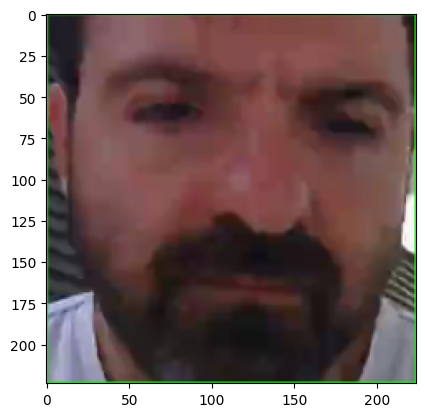

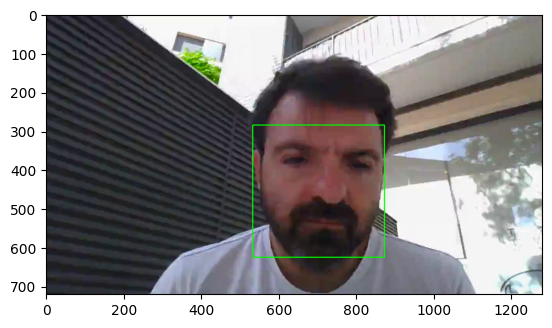

---------------- Not smiling ----------------
1/1 [==============================] - 0s 82ms/step
Prediction index 1
Prediction value 0.743406355381012
Image after reshape


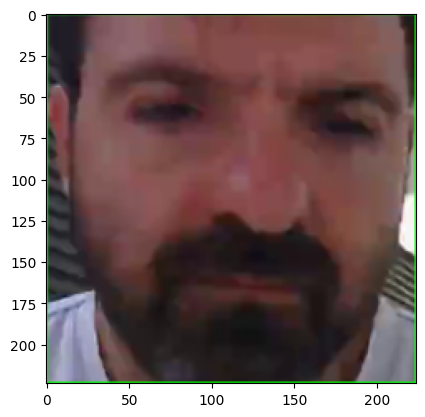

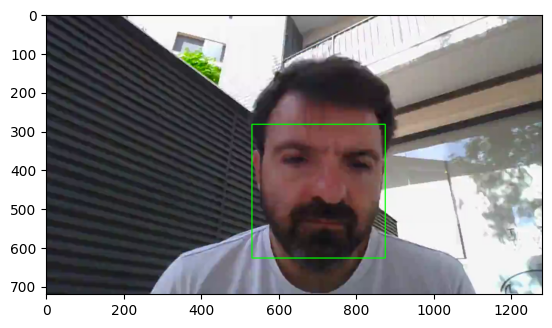

---------------- Not smiling ----------------
1/1 [==============================] - 0s 83ms/step
Prediction index 0
Prediction value 0.547702431678772
Image after reshape


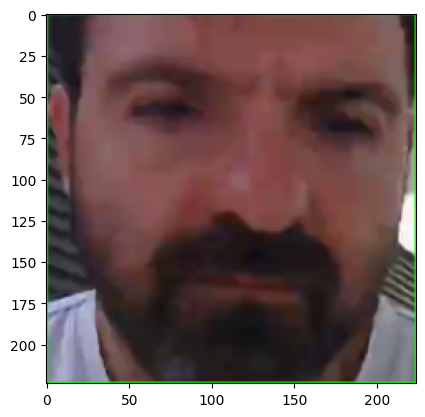

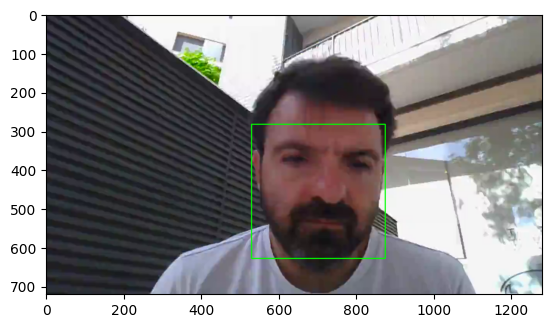

---------------- Not smiling ----------------
1/1 [==============================] - 0s 75ms/step
Prediction index 1
Prediction value 0.7491965293884277
Image after reshape


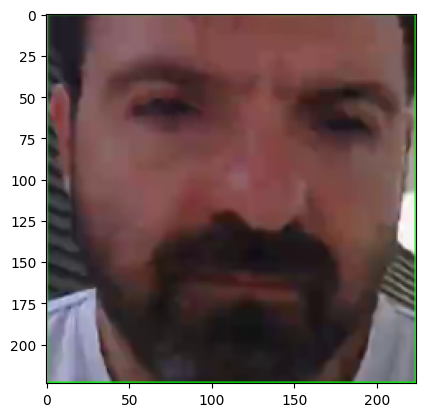

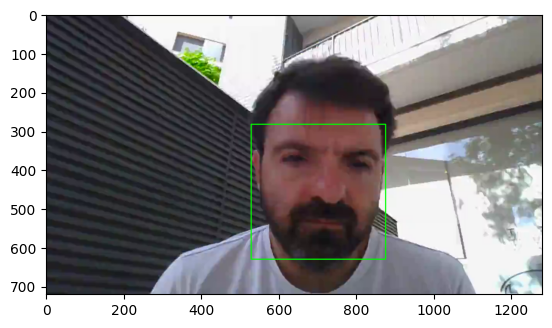

---------------- Not smiling ----------------
1/1 [==============================] - 0s 84ms/step
Prediction index 1
Prediction value 0.7085261344909668
Image after reshape


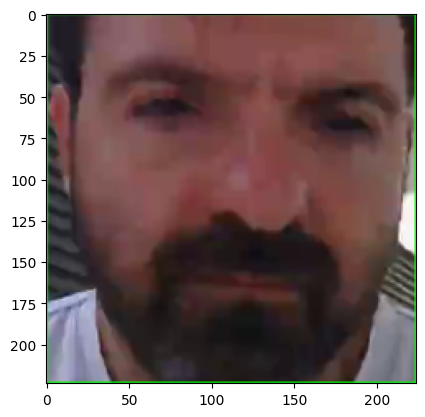

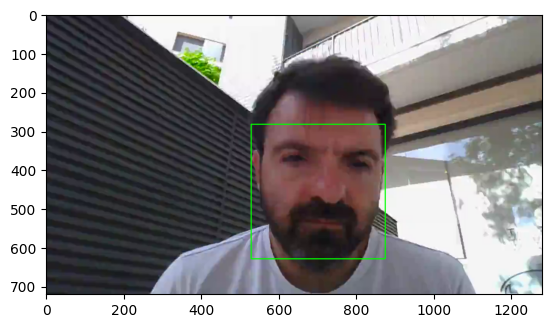

---------------- Not smiling ----------------
1/1 [==============================] - 0s 69ms/step
Prediction index 1
Prediction value 0.7040334343910217
Image after reshape


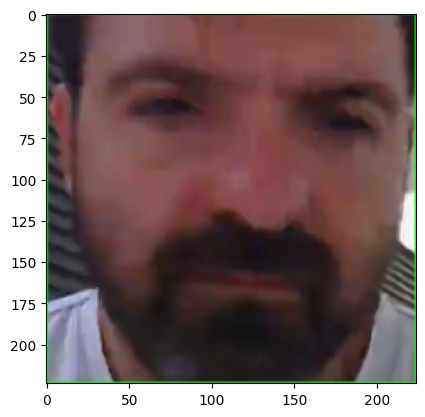

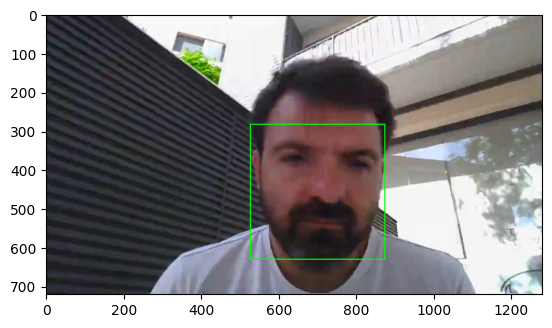

---------------- Not smiling ----------------
1/1 [==============================] - 0s 70ms/step
Prediction index 0
Prediction value 0.5570223331451416
Image after reshape


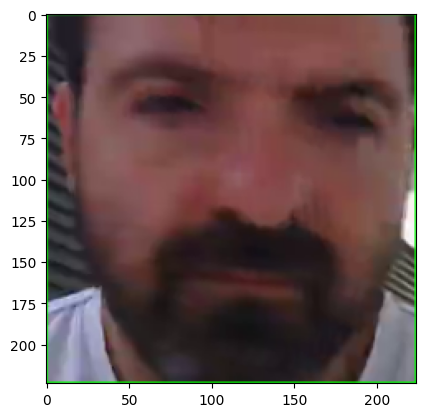

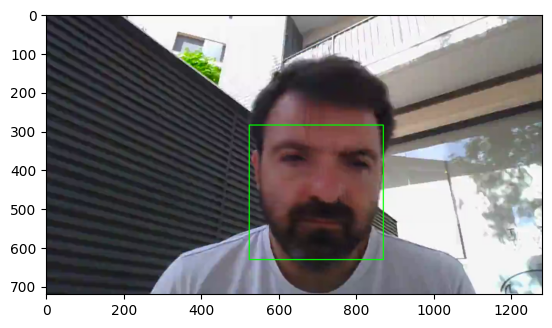

---------------- Not smiling ----------------
1/1 [==============================] - 0s 65ms/step
Prediction index 1
Prediction value 0.8175230622291565
Image after reshape


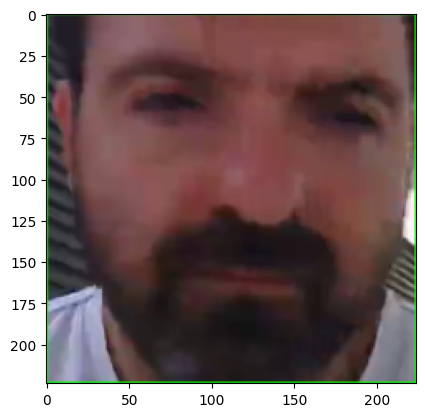

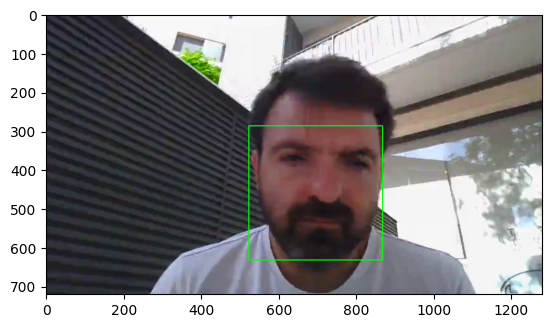

---------------- Not smiling ----------------
1/1 [==============================] - 0s 69ms/step
Prediction index 1
Prediction value 0.5957059860229492
Image after reshape


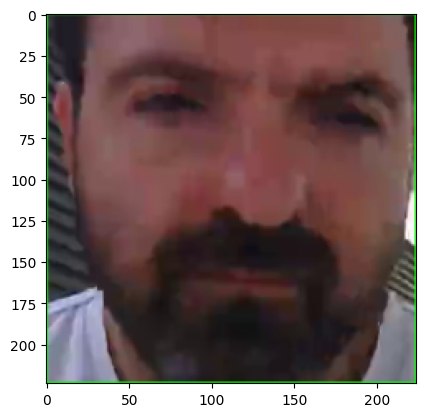

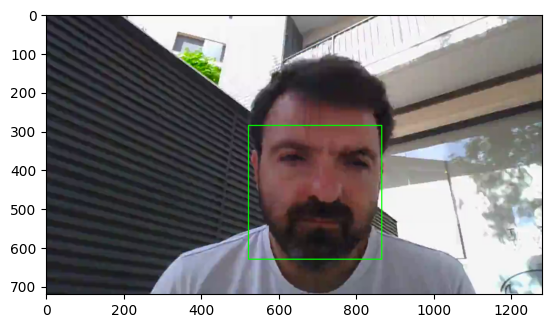

---------------- Not smiling ----------------
1/1 [==============================] - 0s 70ms/step
Prediction index 1
Prediction value 0.9308300614356995
Image after reshape


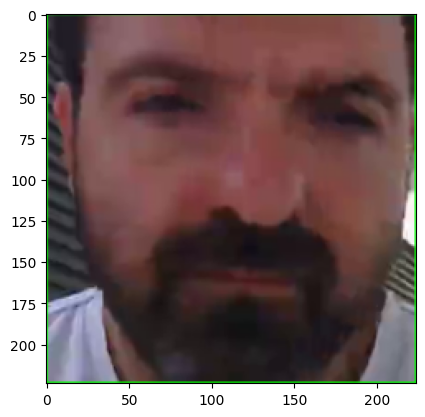

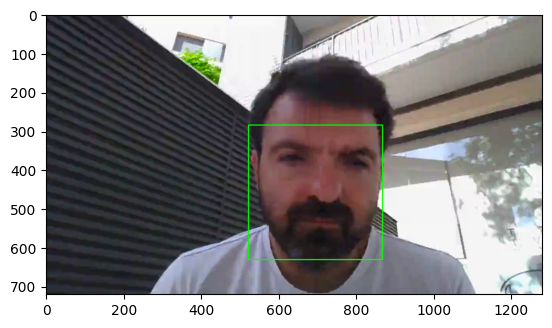

---------------- Smiling ----------------
1/1 [==============================] - 0s 70ms/step
Prediction index 0
Prediction value 0.6430653929710388
Image after reshape


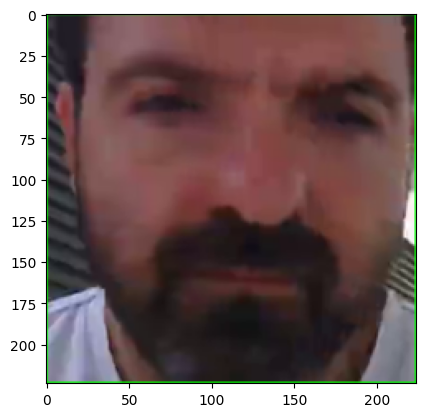

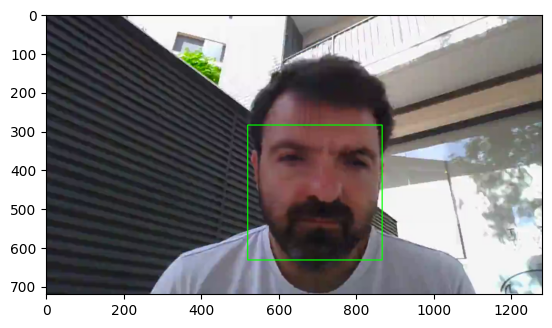

---------------- Not smiling ----------------
1/1 [==============================] - 0s 171ms/step
Prediction index 0
Prediction value 0.6407577395439148
Image after reshape


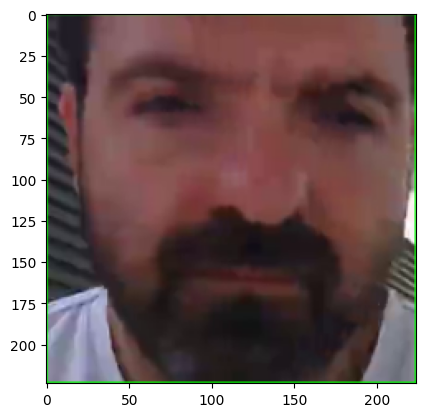

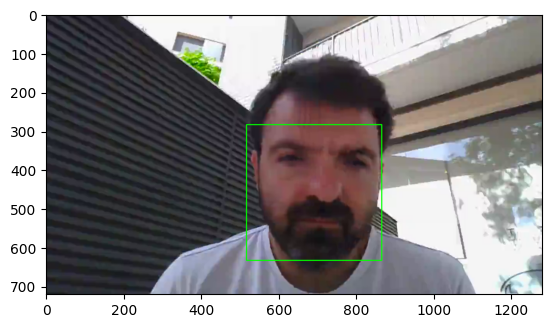

---------------- Not smiling ----------------
1/1 [==============================] - 0s 142ms/step
Prediction index 1
Prediction value 0.7161126732826233
Image after reshape


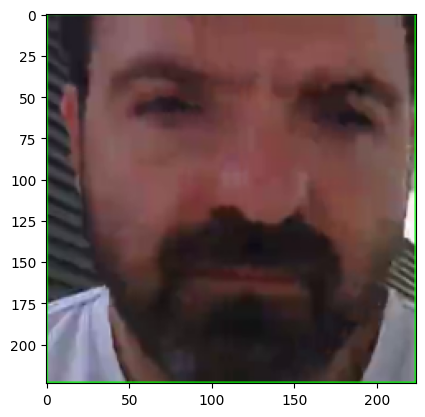

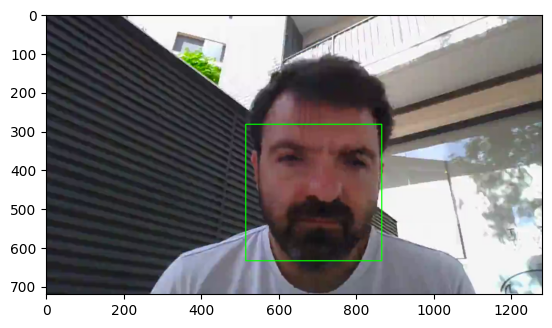

---------------- Not smiling ----------------
1/1 [==============================] - 0s 158ms/step
Prediction index 1
Prediction value 0.5218492746353149
Image after reshape


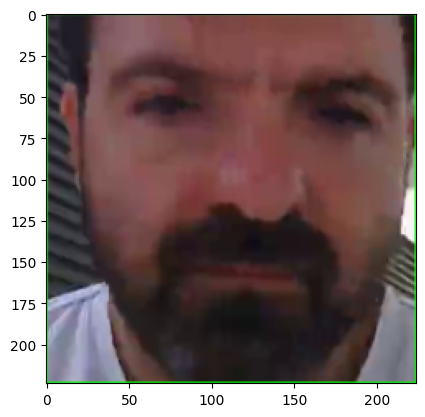

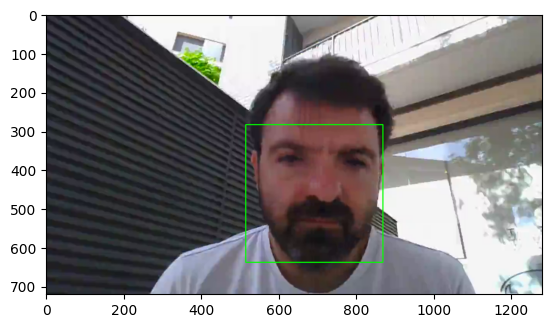

---------------- Not smiling ----------------
1/1 [==============================] - 0s 146ms/step
Prediction index 1
Prediction value 0.8021542429924011
Image after reshape


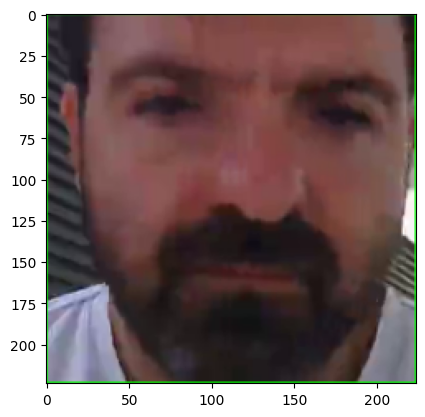

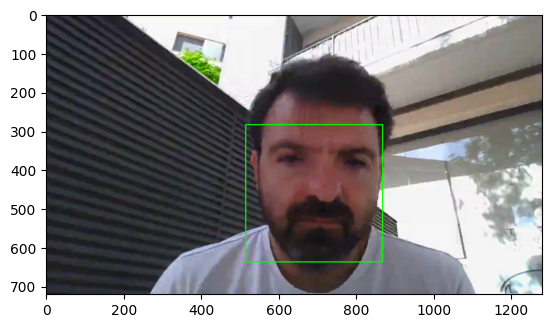

---------------- Not smiling ----------------
1/1 [==============================] - 0s 94ms/step
Prediction index 1
Prediction value 0.873516321182251
Image after reshape


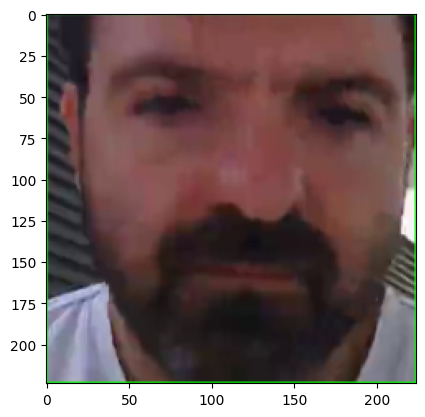

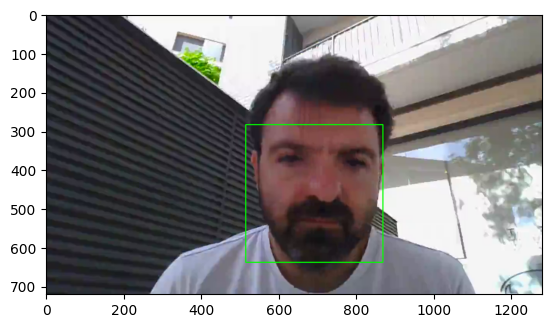

---------------- Not smiling ----------------
1/1 [==============================] - 0s 101ms/step
Prediction index 1
Prediction value 0.9063386917114258
Image after reshape


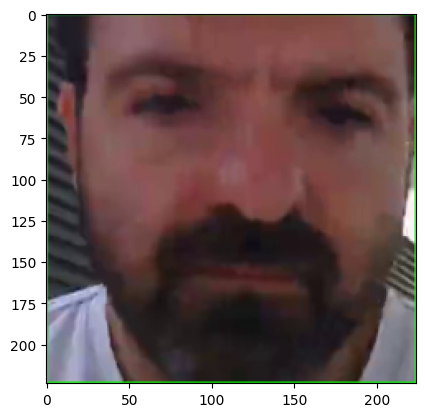

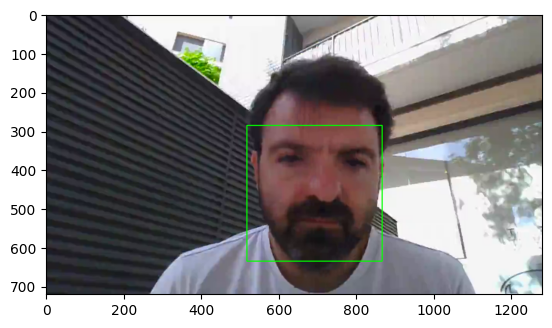

---------------- Smiling ----------------
1/1 [==============================] - 0s 95ms/step
Prediction index 1
Prediction value 0.7315659523010254
Image after reshape


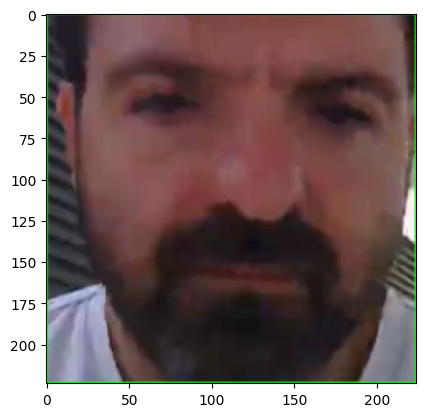

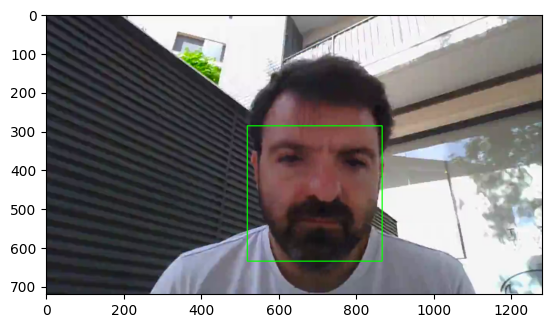

---------------- Not smiling ----------------
1/1 [==============================] - 0s 101ms/step
Prediction index 1
Prediction value 0.6610456109046936
Image after reshape


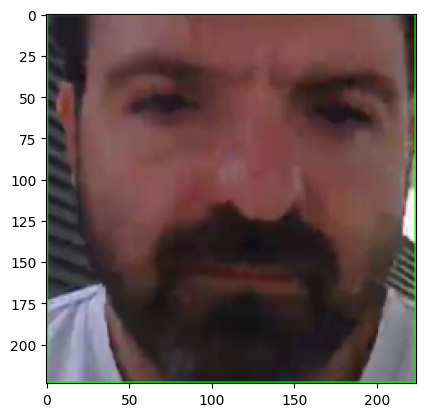

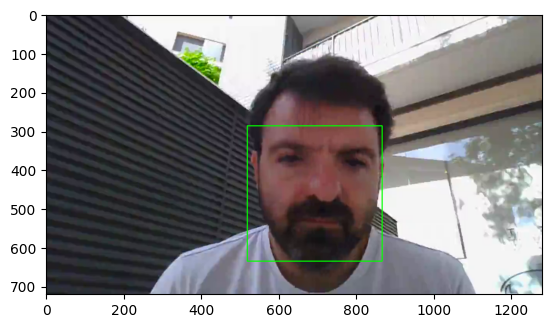

---------------- Not smiling ----------------
1/1 [==============================] - 0s 121ms/step
Prediction index 0
Prediction value 0.5205780863761902
Image after reshape


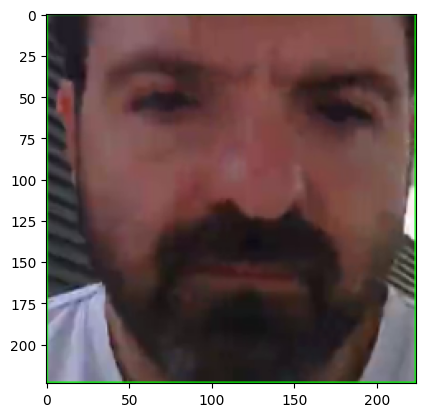

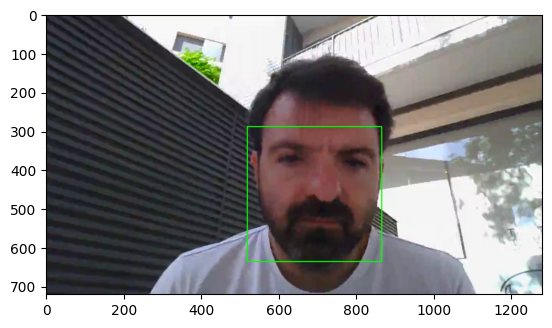

---------------- Not smiling ----------------
1/1 [==============================] - 0s 125ms/step
Prediction index 1
Prediction value 0.699297308921814
Image after reshape


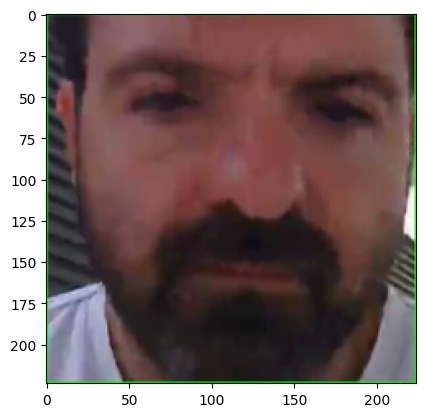

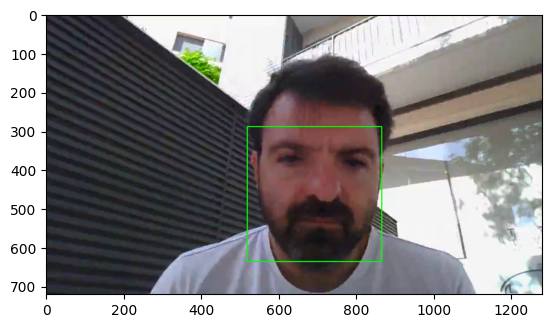

---------------- Not smiling ----------------
1/1 [==============================] - 0s 129ms/step
Prediction index 1
Prediction value 0.8048167824745178
Image after reshape


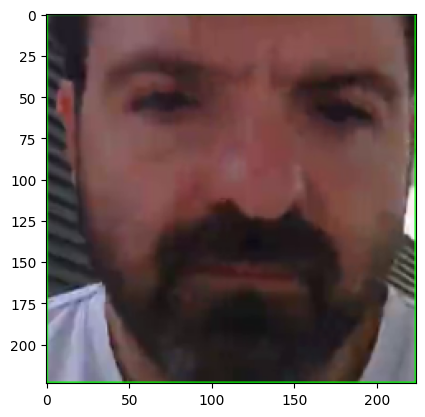

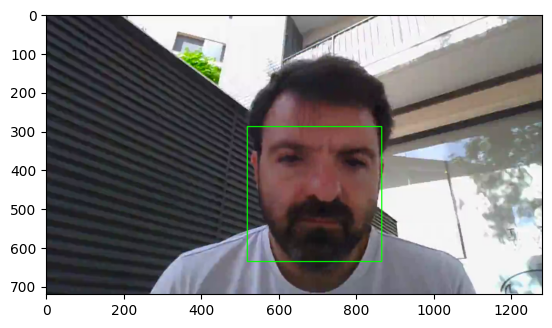

---------------- Not smiling ----------------
1/1 [==============================] - 0s 96ms/step
Prediction index 0
Prediction value 0.5612454414367676
Image after reshape


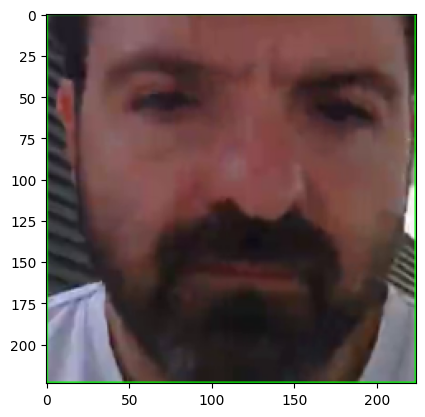

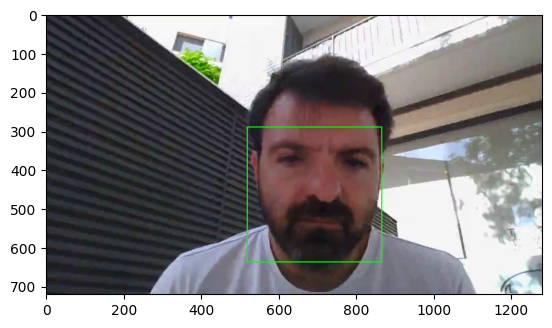

---------------- Not smiling ----------------
1/1 [==============================] - 0s 100ms/step
Prediction index 1
Prediction value 0.8423267006874084
Image after reshape


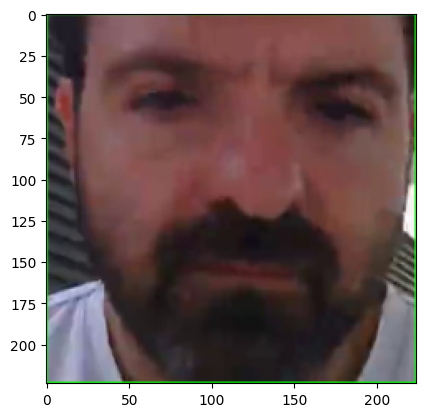

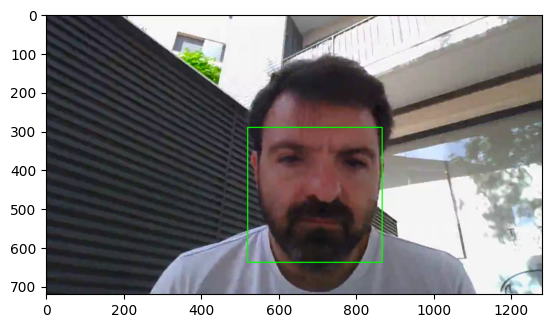

---------------- Not smiling ----------------
1/1 [==============================] - 0s 135ms/step
Prediction index 1
Prediction value 0.8886670470237732
Image after reshape


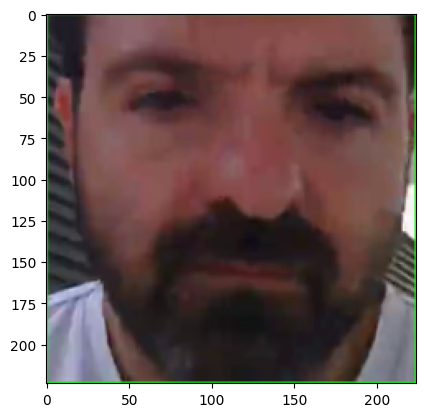

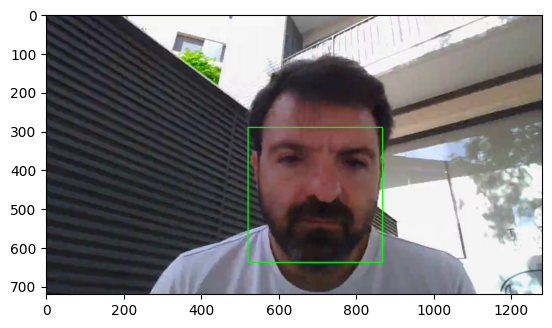

---------------- Not smiling ----------------
1/1 [==============================] - 0s 174ms/step
Prediction index 1
Prediction value 0.938470721244812
Image after reshape


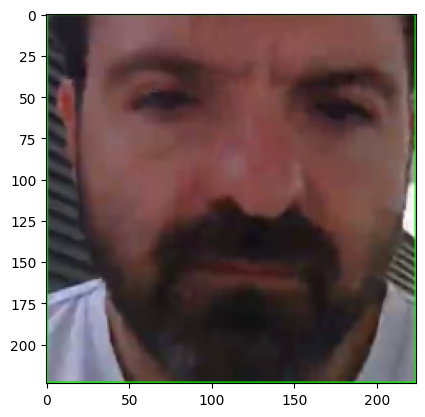

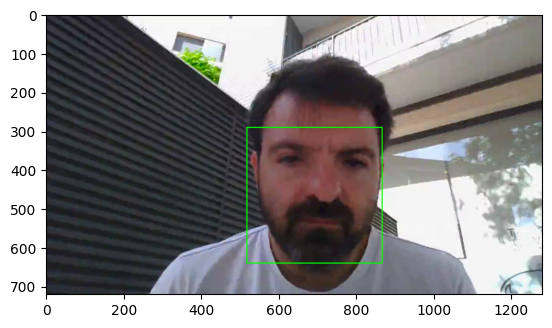

---------------- Smiling ----------------
1/1 [==============================] - 0s 153ms/step
Prediction index 1
Prediction value 0.6915926337242126
Image after reshape


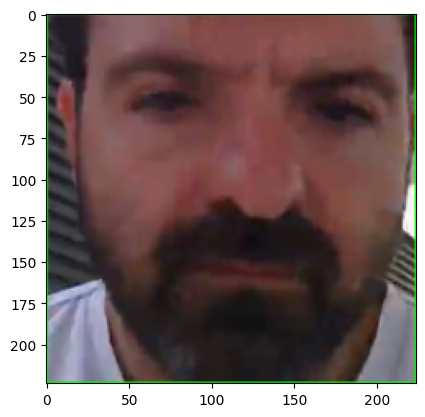

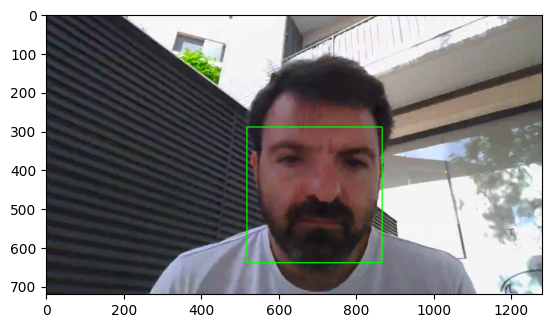

---------------- Not smiling ----------------
1/1 [==============================] - 0s 138ms/step
Prediction index 1
Prediction value 0.8573636412620544
Image after reshape


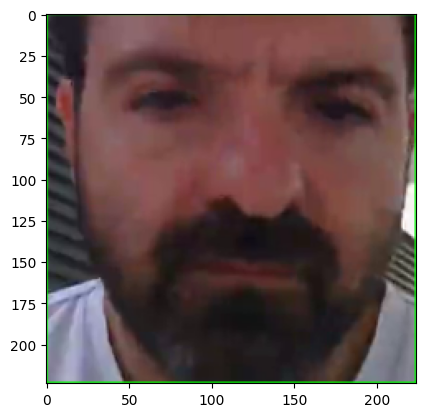

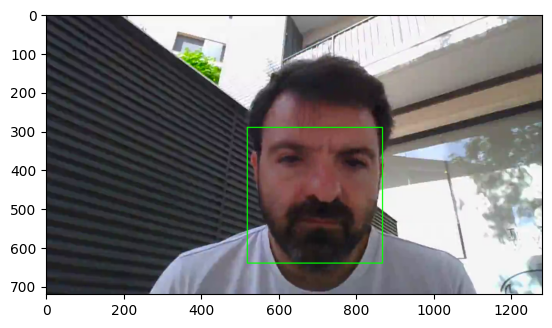

---------------- Not smiling ----------------
1/1 [==============================] - 0s 123ms/step
Prediction index 1
Prediction value 0.8839131593704224
Image after reshape


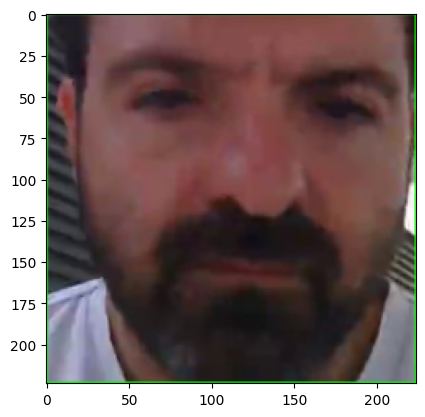

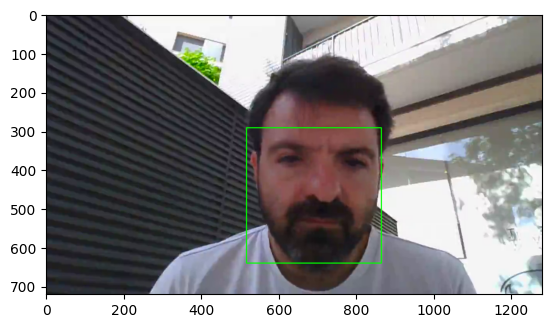

---------------- Not smiling ----------------
1/1 [==============================] - 0s 121ms/step
Prediction index 1
Prediction value 0.9297551512718201
Image after reshape


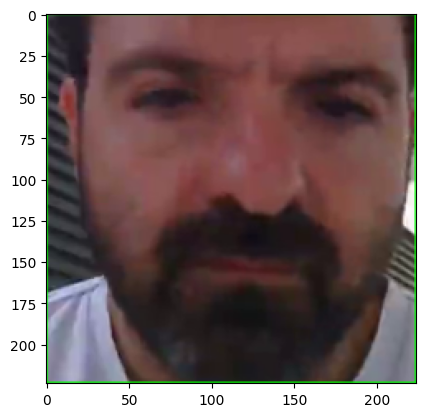

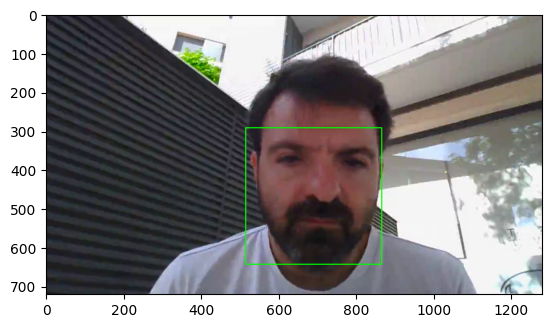

---------------- Smiling ----------------
1/1 [==============================] - 0s 126ms/step
Prediction index 1
Prediction value 0.9666397571563721
Image after reshape


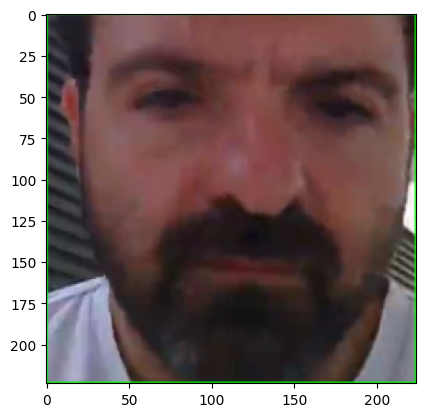

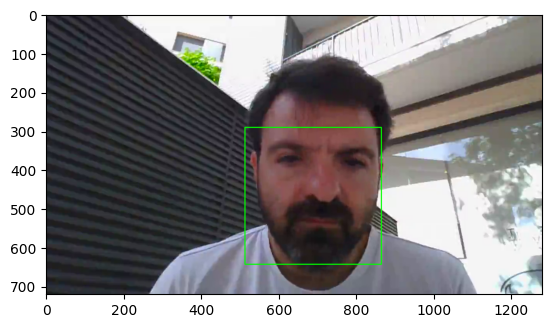

---------------- Smiling ----------------
1/1 [==============================] - 0s 120ms/step
Prediction index 1
Prediction value 0.9076964855194092
Image after reshape


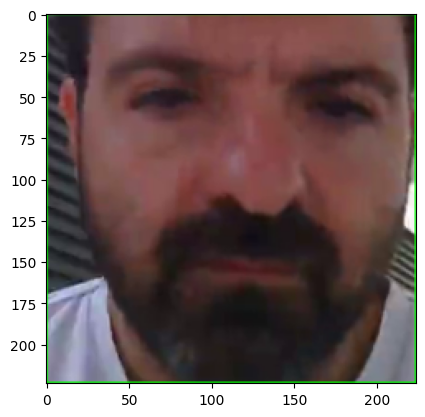

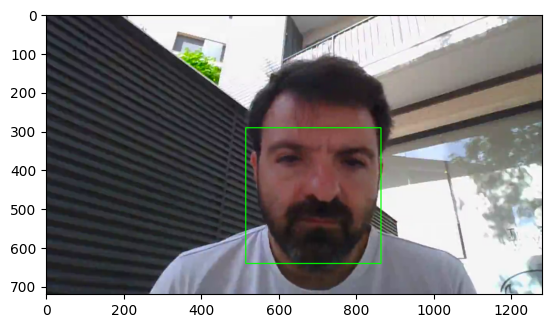

---------------- Smiling ----------------
1/1 [==============================] - 0s 121ms/step
Prediction index 1
Prediction value 0.9594006538391113
Image after reshape


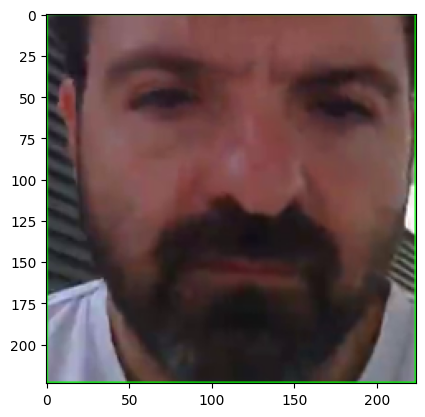

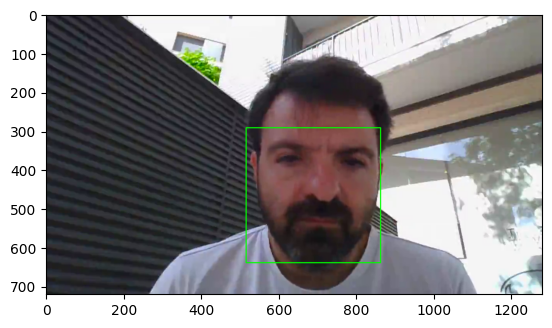

---------------- Smiling ----------------
1/1 [==============================] - 0s 102ms/step
Prediction index 1
Prediction value 0.6342228055000305
Image after reshape


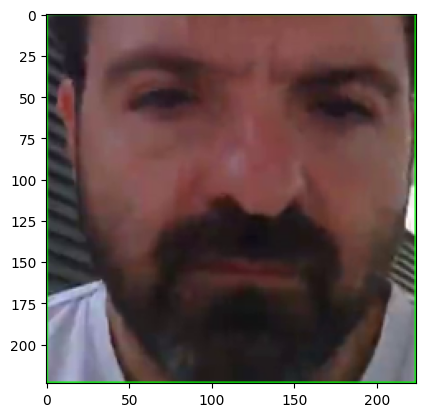

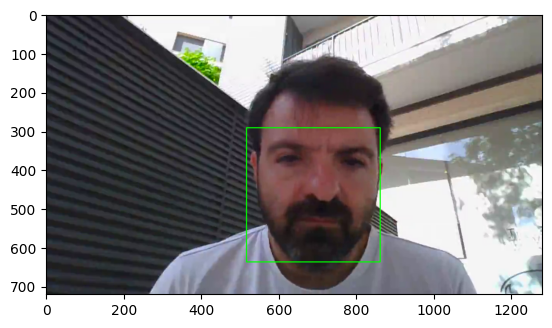

---------------- Not smiling ----------------
1/1 [==============================] - 0s 98ms/step
Prediction index 1
Prediction value 0.8515294194221497
Image after reshape


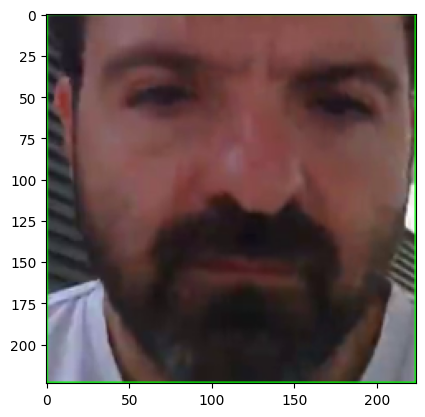

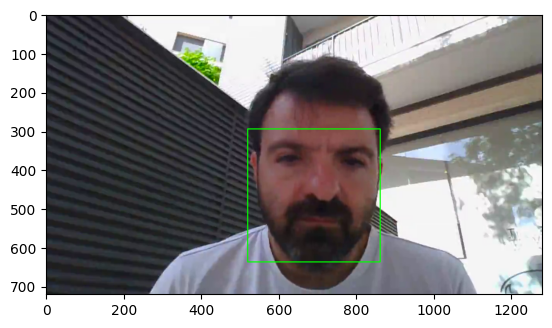

---------------- Not smiling ----------------
1/1 [==============================] - 0s 98ms/step
Prediction index 1
Prediction value 0.9591425657272339
Image after reshape


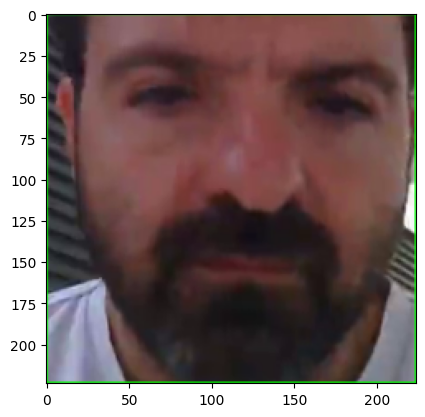

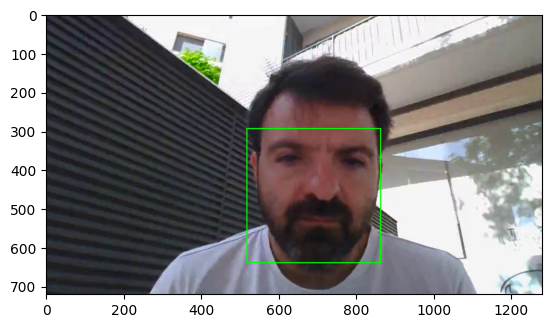

---------------- Smiling ----------------
1/1 [==============================] - 0s 105ms/step
Prediction index 1
Prediction value 0.9240285158157349
Image after reshape


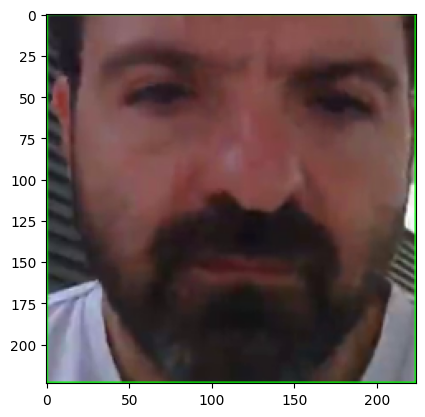

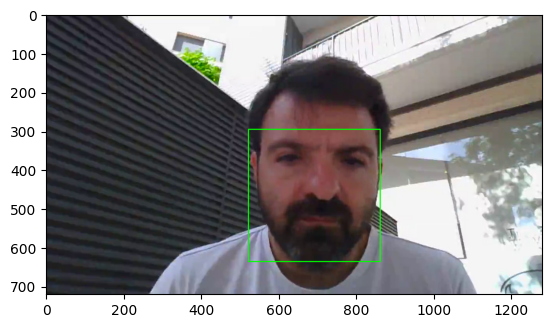

---------------- Smiling ----------------
1/1 [==============================] - 0s 131ms/step
Prediction index 1
Prediction value 0.6695582270622253
Image after reshape


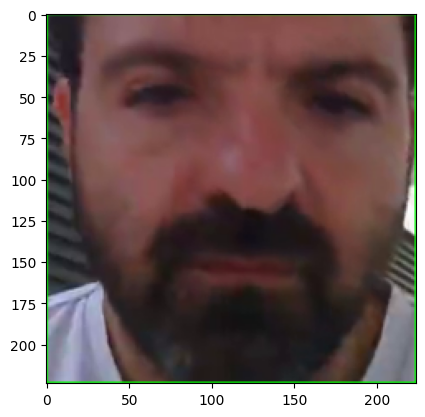

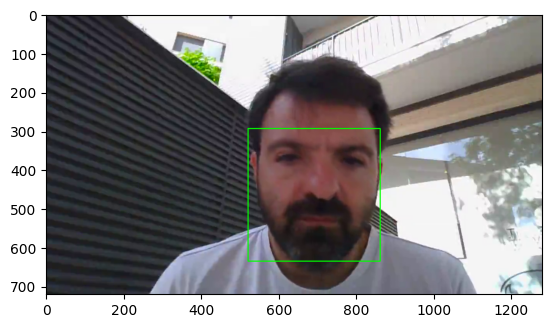

---------------- Not smiling ----------------
1/1 [==============================] - 0s 177ms/step
Prediction index 1
Prediction value 0.7557865381240845
Image after reshape


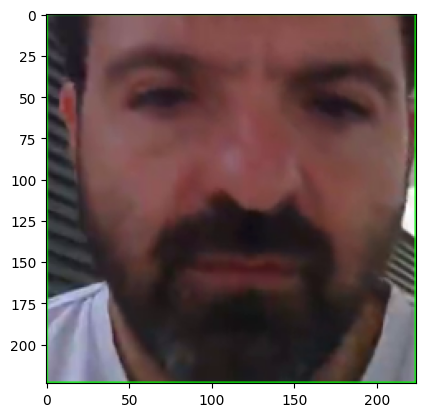

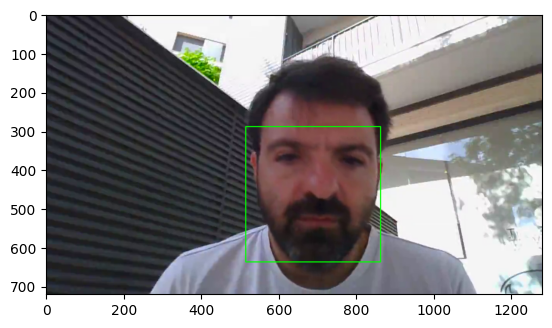

---------------- Not smiling ----------------
1/1 [==============================] - 0s 102ms/step
Prediction index 1
Prediction value 0.9487031698226929
Image after reshape


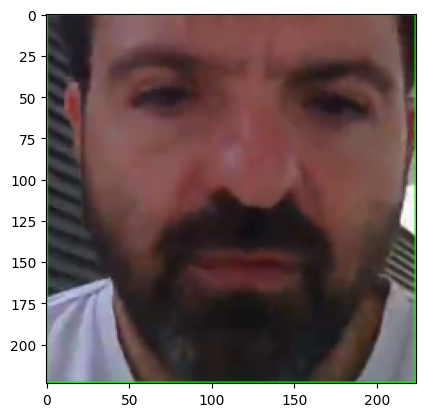

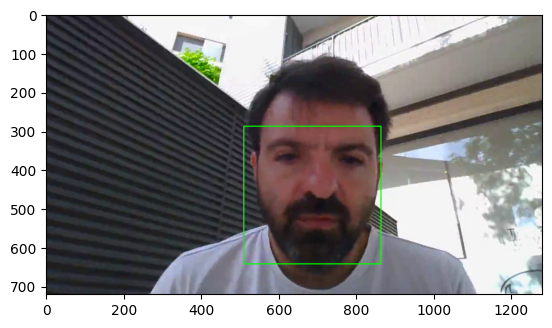

---------------- Smiling ----------------
1/1 [==============================] - 0s 133ms/step
Prediction index 0
Prediction value 0.8742936253547668
Image after reshape


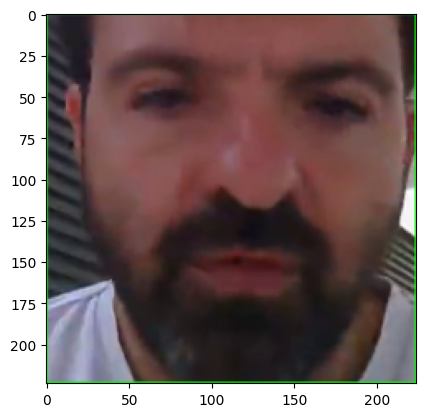

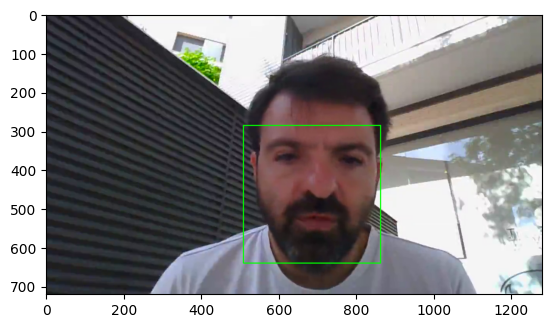

---------------- Not smiling ----------------
1/1 [==============================] - 0s 176ms/step
Prediction index 1
Prediction value 0.810868501663208
Image after reshape


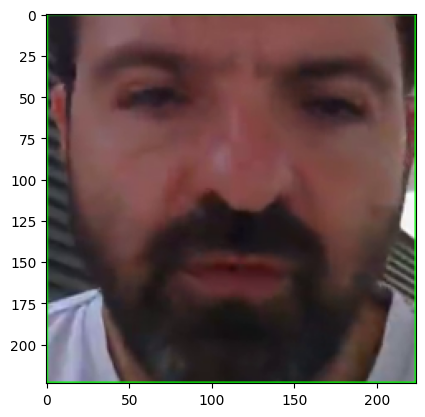

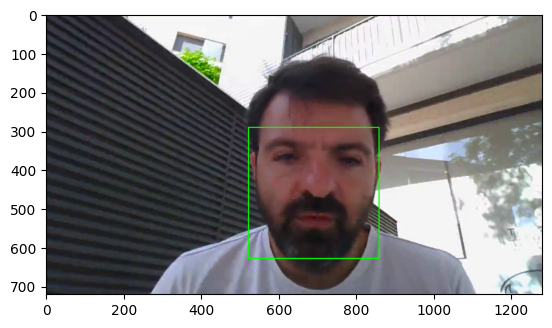

---------------- Not smiling ----------------
1/1 [==============================] - 0s 113ms/step
Prediction index 1
Prediction value 0.644110381603241
Image after reshape


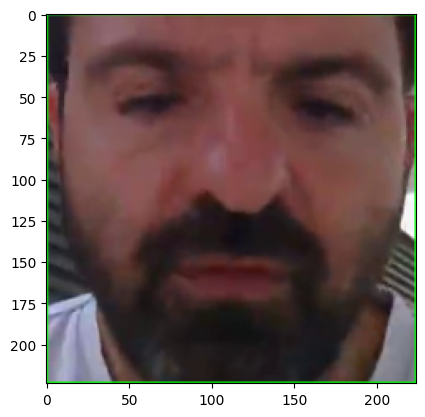

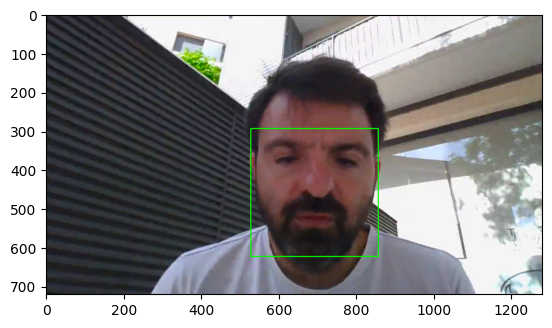

---------------- Not smiling ----------------
1/1 [==============================] - 0s 119ms/step
Prediction index 0
Prediction value 0.5095373392105103
Image after reshape


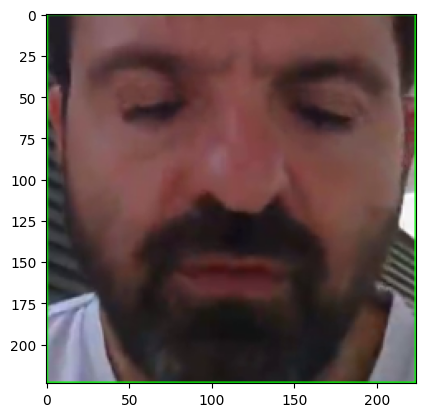

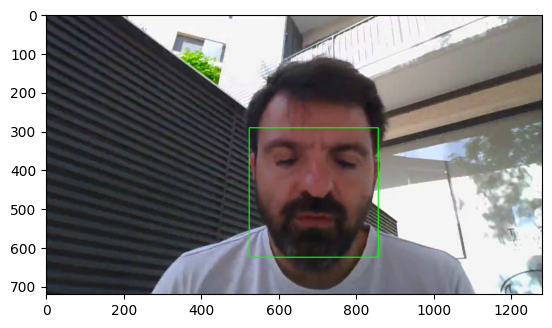

---------------- Not smiling ----------------
1/1 [==============================] - 0s 104ms/step
Prediction index 1
Prediction value 0.5925122499465942
Image after reshape


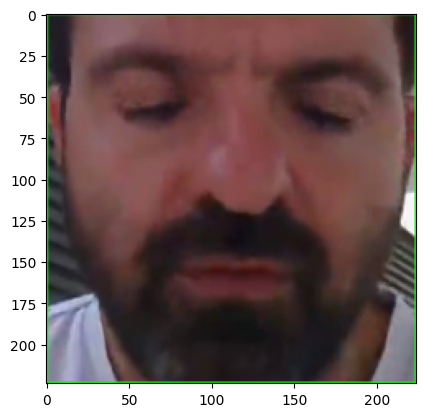

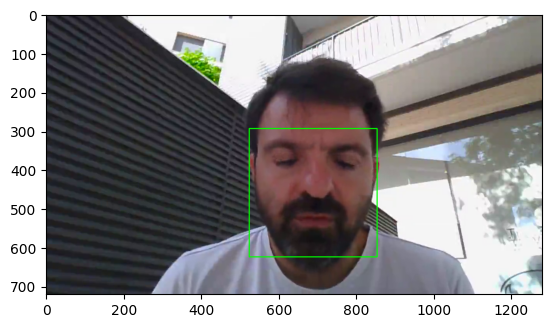

---------------- Not smiling ----------------
1/1 [==============================] - 0s 97ms/step
Prediction index 1
Prediction value 0.5809641480445862
Image after reshape


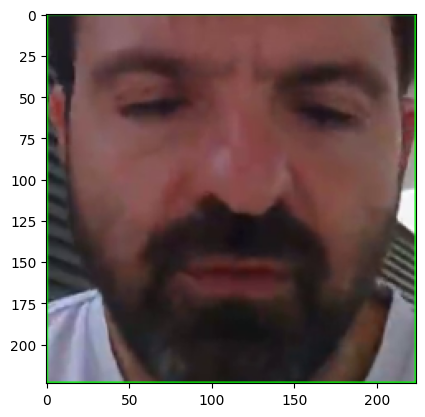

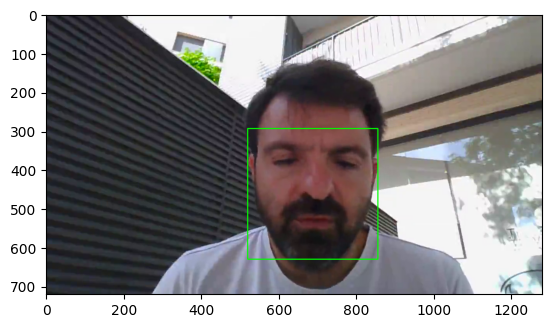

---------------- Not smiling ----------------
1/1 [==============================] - 0s 99ms/step
Prediction index 0
Prediction value 0.5801302790641785
Image after reshape


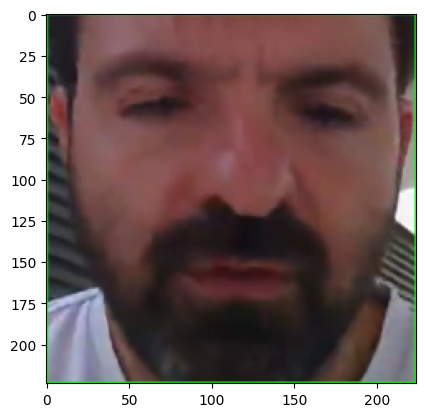

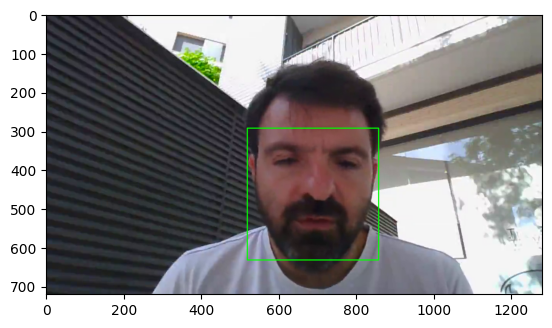

---------------- Not smiling ----------------
1/1 [==============================] - 0s 99ms/step
Prediction index 1
Prediction value 0.7632303833961487
Image after reshape


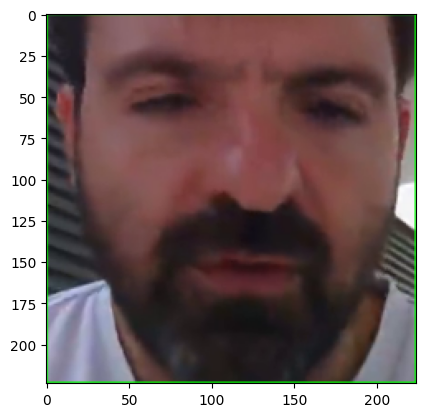

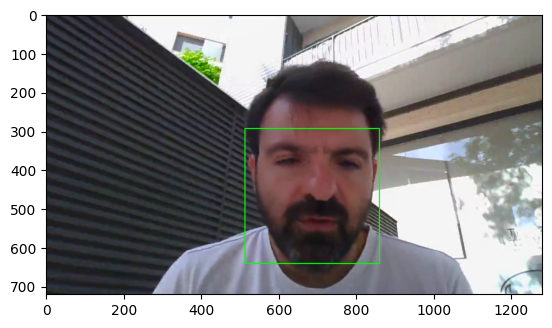

---------------- Not smiling ----------------
1/1 [==============================] - 0s 128ms/step
Prediction index 0
Prediction value 0.9125209450721741
Image after reshape


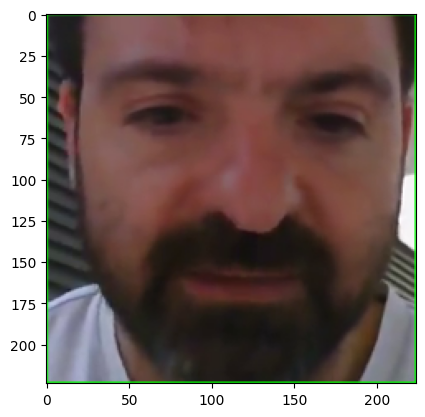

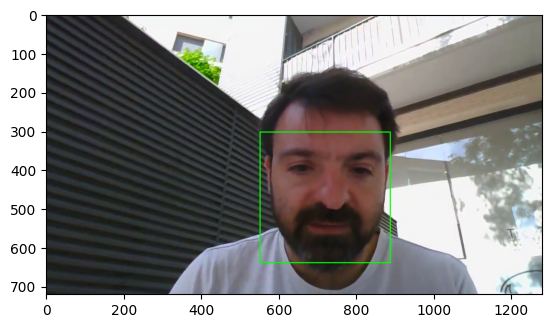

---------------- Not smiling ----------------
1/1 [==============================] - 0s 138ms/step
Prediction index 0
Prediction value 0.7643842697143555
Image after reshape


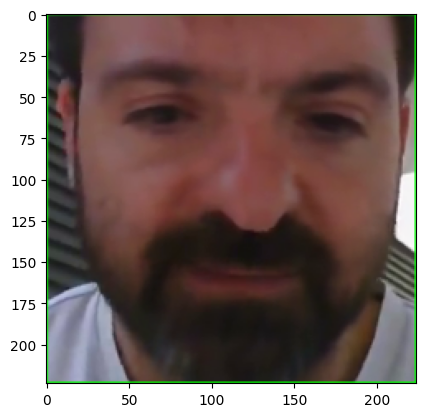

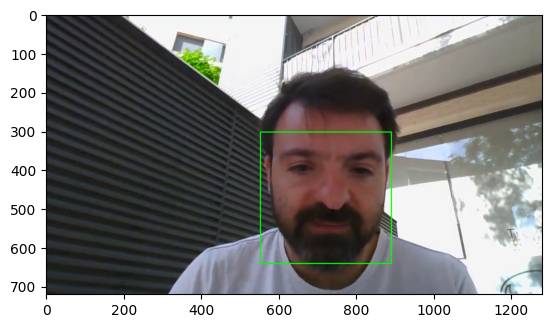

---------------- Not smiling ----------------
1/1 [==============================] - 0s 96ms/step
Prediction index 0
Prediction value 0.5674942135810852
Image after reshape


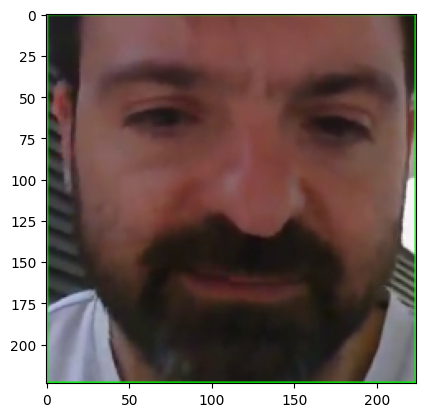

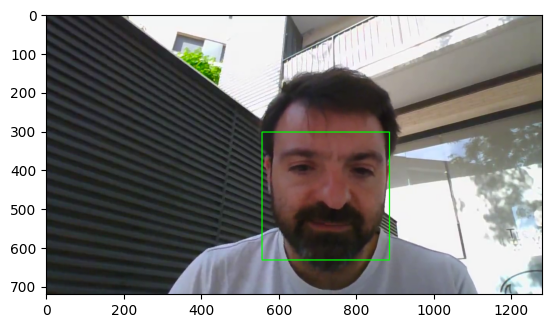

---------------- Not smiling ----------------
1/1 [==============================] - 0s 97ms/step
Prediction index 0
Prediction value 0.6898502707481384
Image after reshape


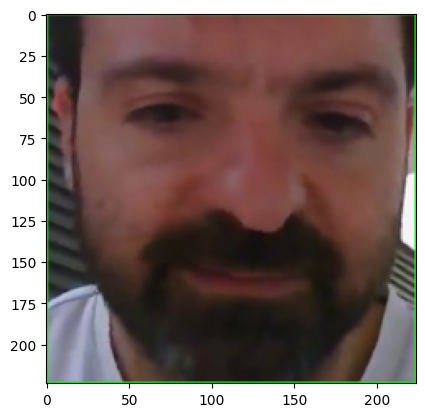

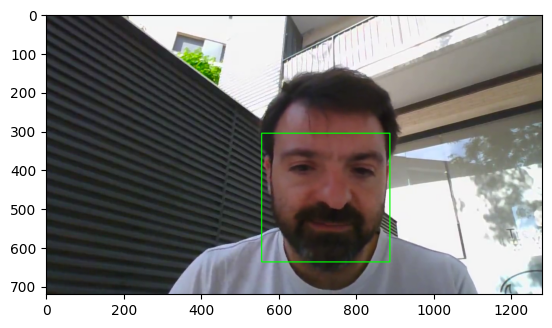

---------------- Not smiling ----------------
1/1 [==============================] - 0s 100ms/step
Prediction index 1
Prediction value 0.5360363125801086
Image after reshape


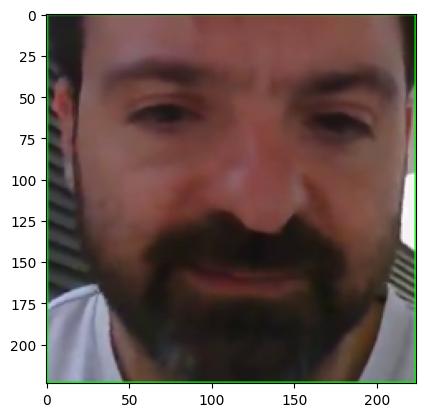

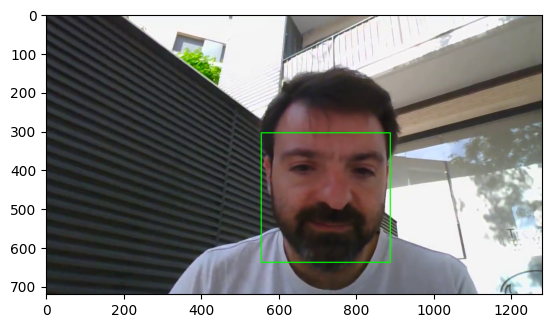

---------------- Not smiling ----------------
1/1 [==============================] - 0s 117ms/step
Prediction index 1
Prediction value 0.576057493686676
Image after reshape


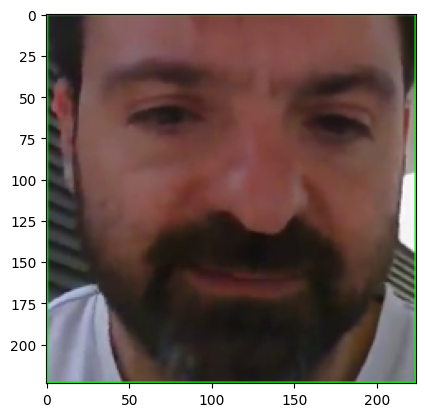

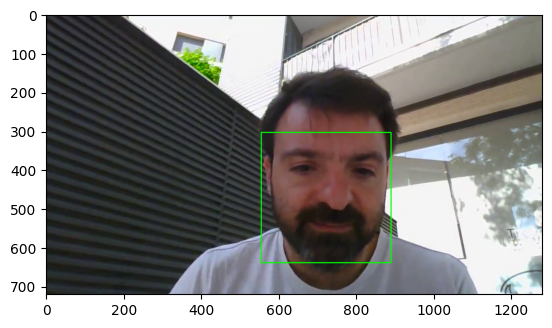

---------------- Not smiling ----------------
1/1 [==============================] - 0s 104ms/step
Prediction index 1
Prediction value 0.6681339144706726
Image after reshape


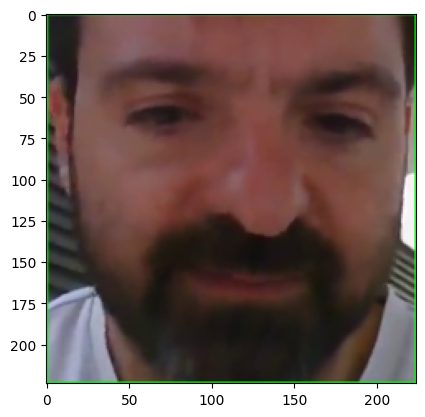

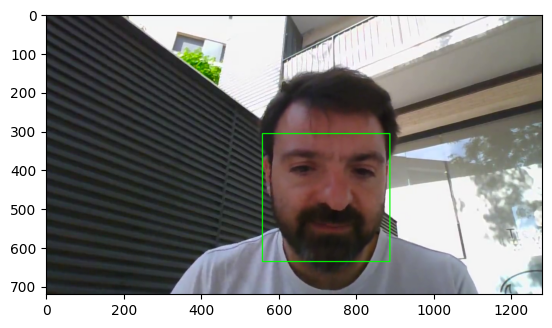

---------------- Not smiling ----------------
1/1 [==============================] - 0s 100ms/step
Prediction index 0
Prediction value 0.7205735445022583
Image after reshape


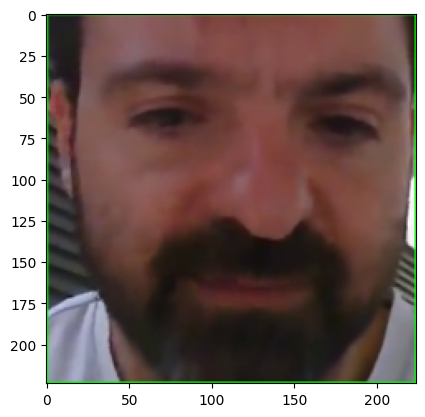

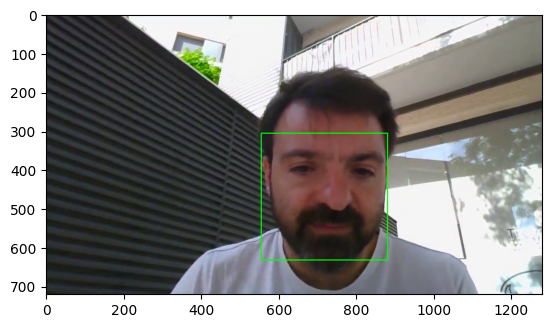

---------------- Not smiling ----------------
1/1 [==============================] - 0s 108ms/step
Prediction index 1
Prediction value 0.8777775168418884
Image after reshape


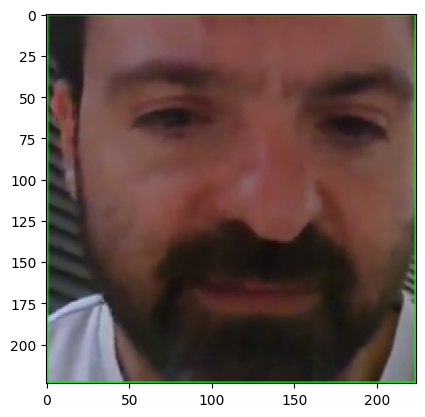

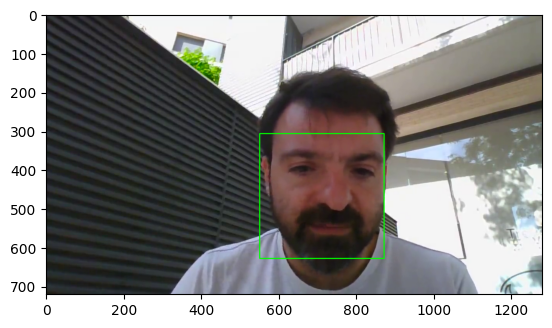

---------------- Not smiling ----------------
1/1 [==============================] - 0s 97ms/step
Prediction index 1
Prediction value 0.6983803510665894
Image after reshape


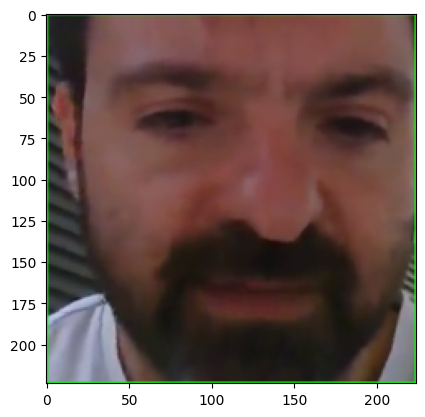

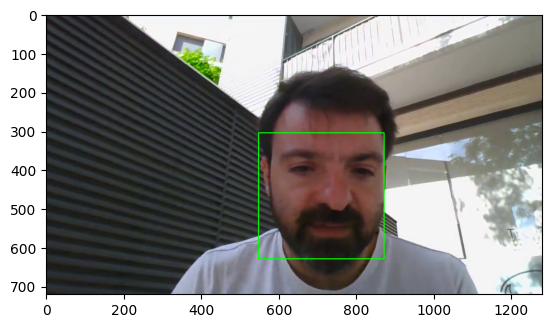

---------------- Not smiling ----------------
1/1 [==============================] - 0s 161ms/step
Prediction index 0
Prediction value 0.5875058174133301
Image after reshape


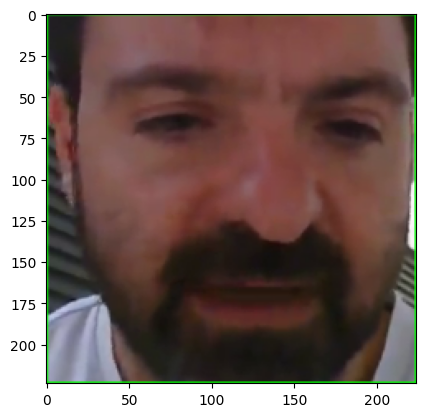

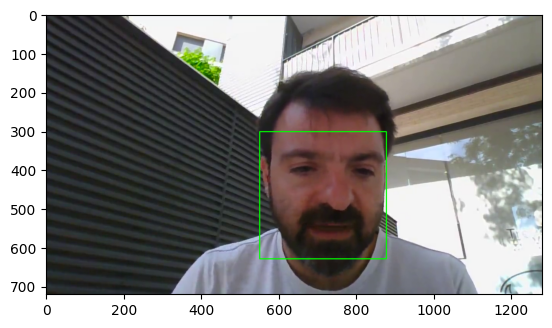

---------------- Not smiling ----------------
1/1 [==============================] - 0s 151ms/step
Prediction index 0
Prediction value 0.7481902837753296
Image after reshape


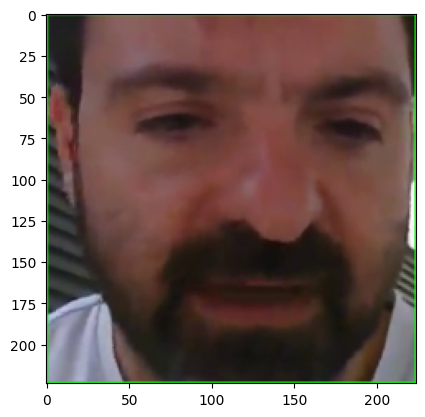

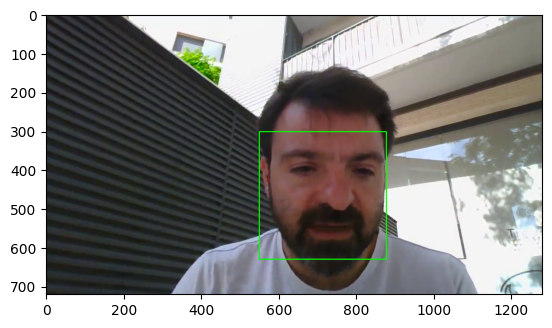

---------------- Not smiling ----------------
1/1 [==============================] - 0s 154ms/step
Prediction index 1
Prediction value 0.7192578315734863
Image after reshape


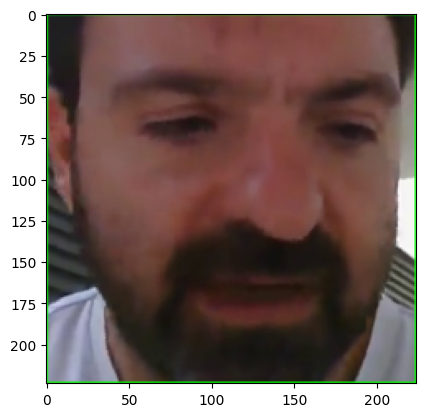

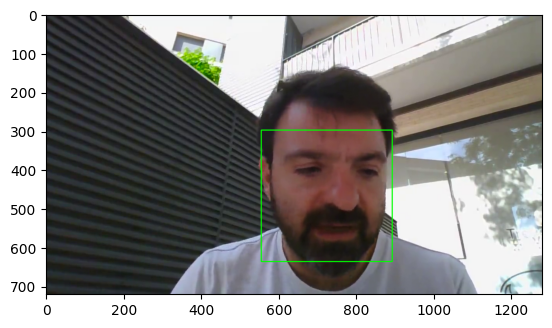

---------------- Not smiling ----------------
1/1 [==============================] - 0s 155ms/step
Prediction index 1
Prediction value 0.5025233626365662
Image after reshape


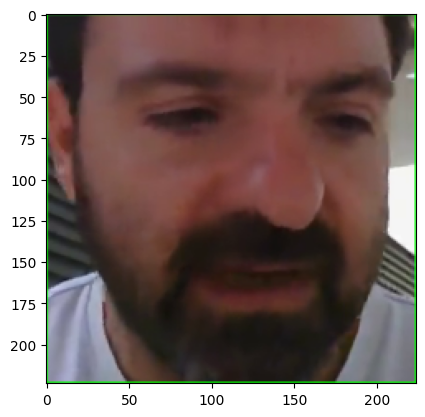

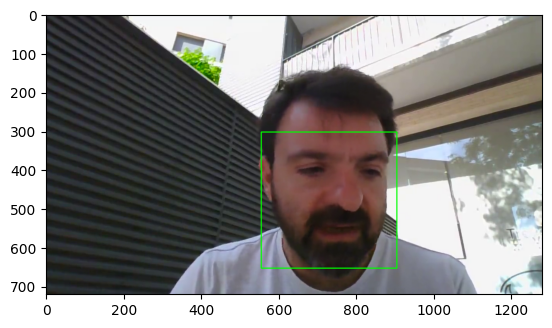

---------------- Not smiling ----------------
1/1 [==============================] - 0s 159ms/step
Prediction index 1
Prediction value 0.6352062225341797
Image after reshape


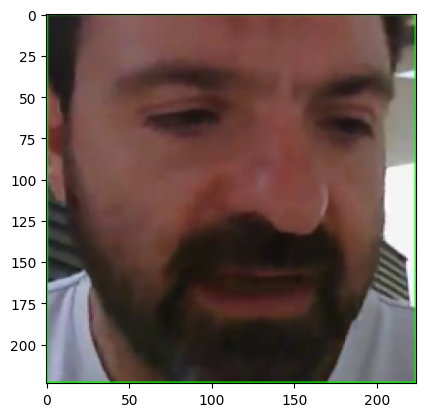

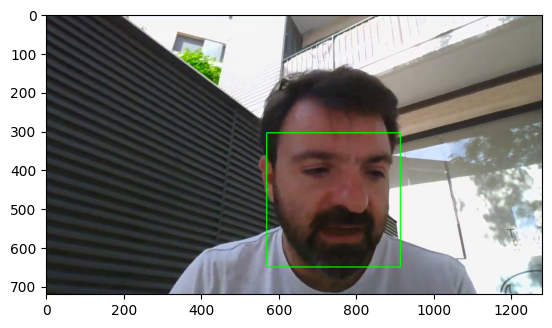

---------------- Not smiling ----------------
1/1 [==============================] - 0s 98ms/step
Prediction index 1
Prediction value 0.7186663746833801
Image after reshape


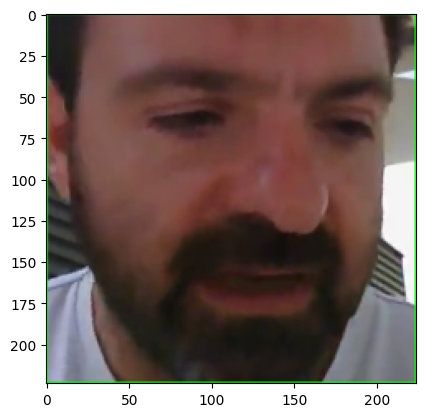

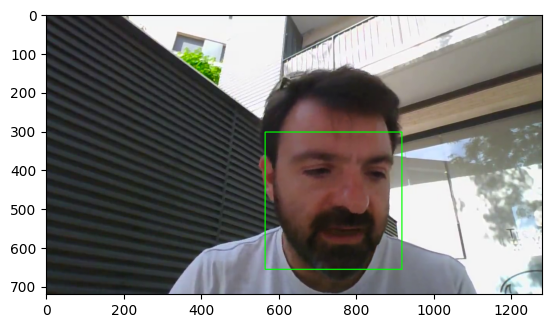

---------------- Not smiling ----------------
1/1 [==============================] - 0s 96ms/step
Prediction index 1
Prediction value 0.6314536333084106
Image after reshape


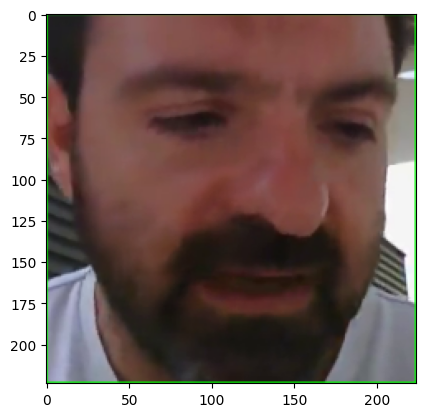

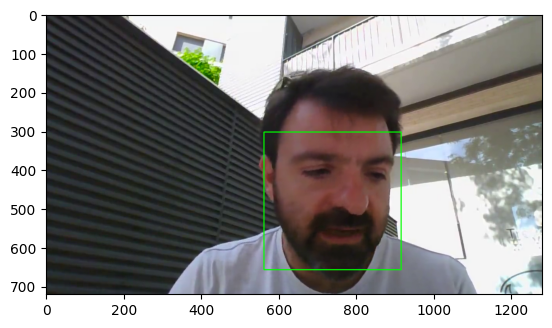

---------------- Not smiling ----------------
1/1 [==============================] - 0s 96ms/step
Prediction index 0
Prediction value 0.5703787207603455
Image after reshape


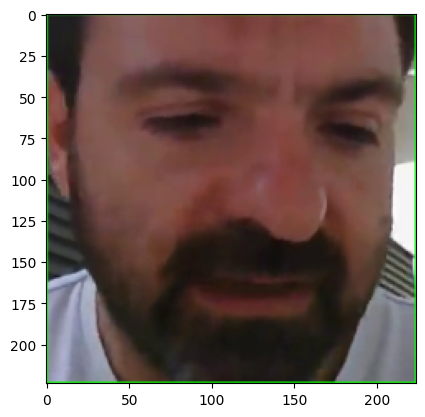

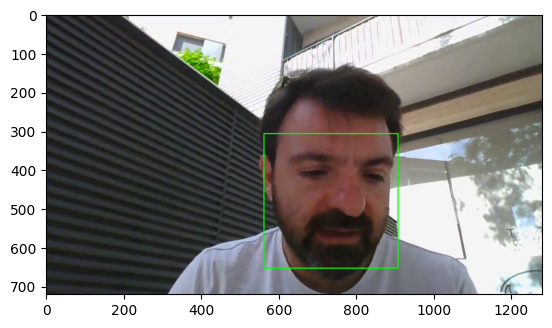

---------------- Not smiling ----------------
1/1 [==============================] - 0s 98ms/step
Prediction index 0
Prediction value 0.6003865599632263
Image after reshape


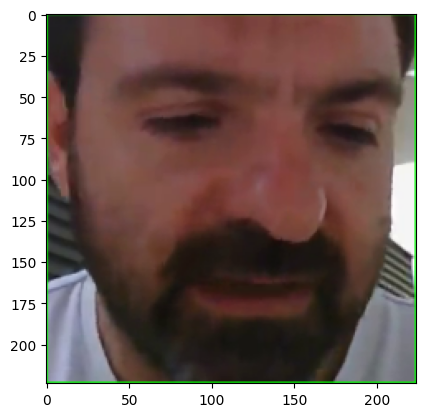

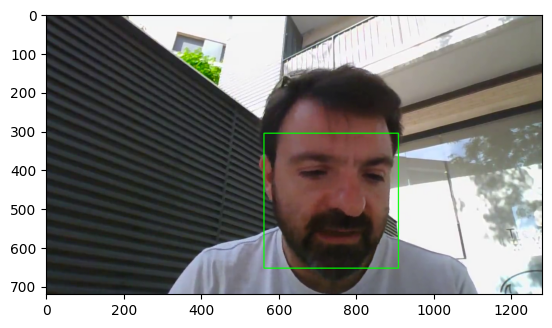

---------------- Not smiling ----------------
1/1 [==============================] - 0s 99ms/step
Prediction index 0
Prediction value 0.6037194132804871
Image after reshape


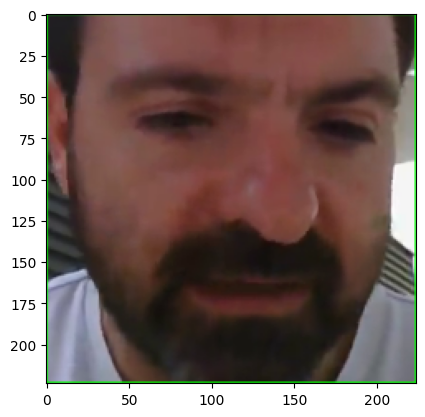

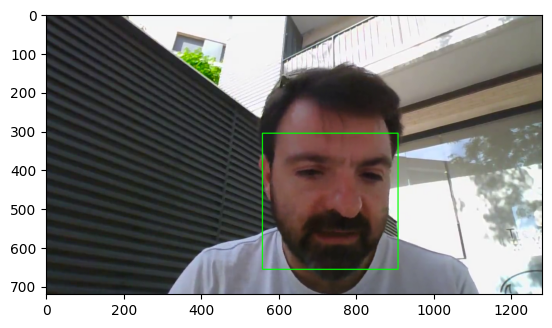

---------------- Not smiling ----------------
1/1 [==============================] - 0s 109ms/step
Prediction index 0
Prediction value 0.7821934819221497
Image after reshape


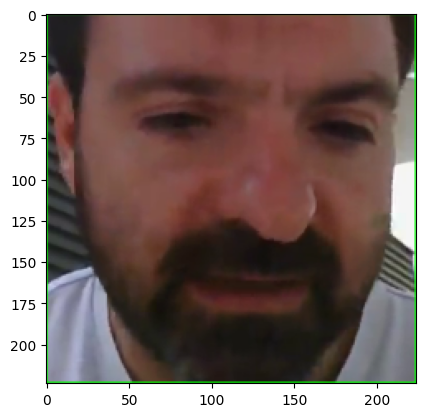

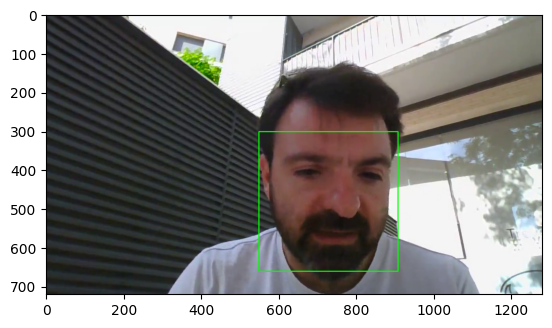

---------------- Not smiling ----------------
1/1 [==============================] - 0s 98ms/step
Prediction index 0
Prediction value 0.7488706707954407
Image after reshape


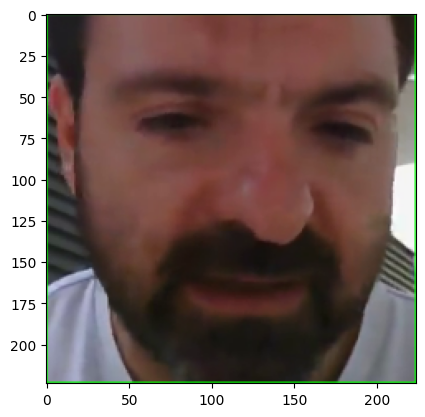

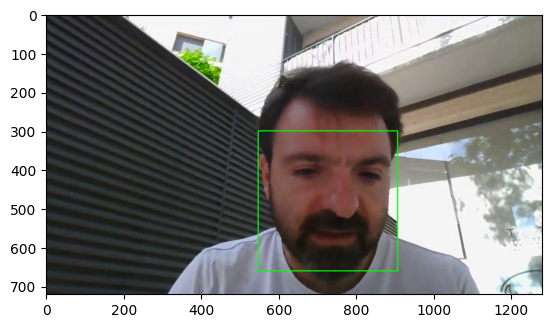

---------------- Not smiling ----------------
1/1 [==============================] - 0s 97ms/step
Prediction index 0
Prediction value 0.7957987189292908
Image after reshape


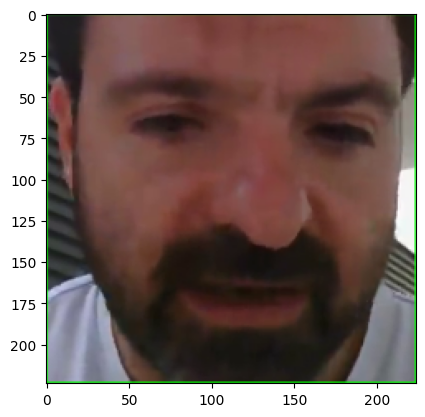

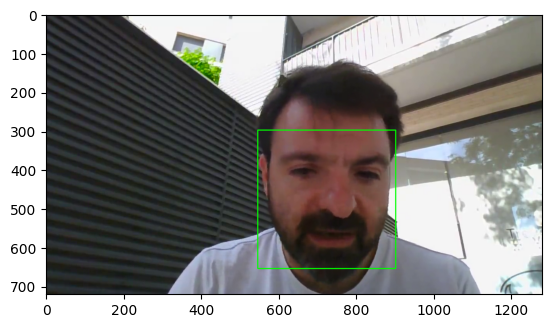

---------------- Not smiling ----------------
1/1 [==============================] - 0s 139ms/step
Prediction index 1
Prediction value 0.6319966912269592
Image after reshape


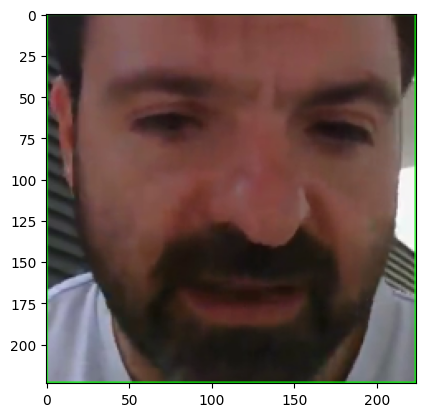

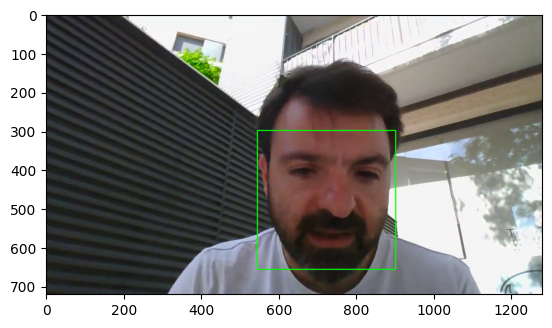

---------------- Not smiling ----------------
1/1 [==============================] - 0s 143ms/step
Prediction index 1
Prediction value 0.5337711572647095
Image after reshape


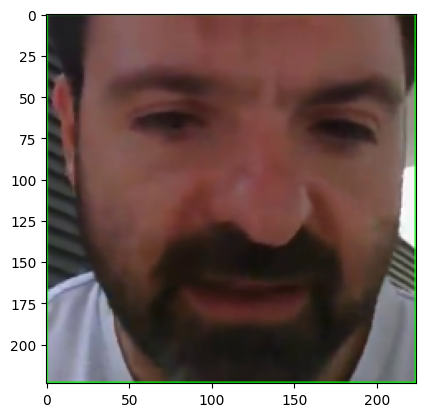

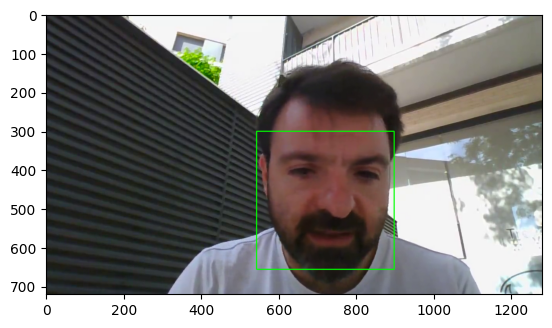

---------------- Not smiling ----------------
1/1 [==============================] - 0s 121ms/step
Prediction index 0
Prediction value 0.9261901378631592
Image after reshape


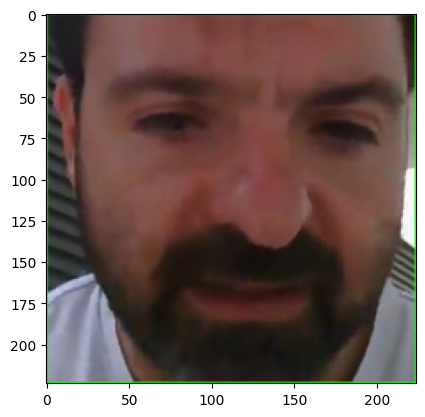

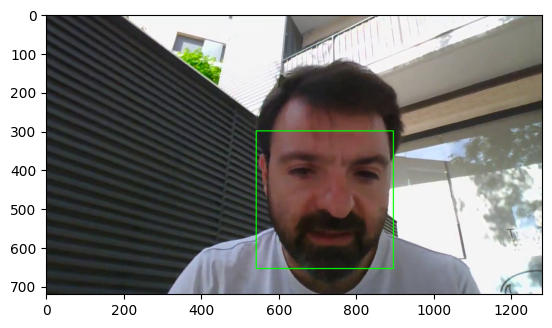

---------------- Not smiling ----------------
1/1 [==============================] - 0s 126ms/step
Prediction index 0
Prediction value 0.8423454165458679
Image after reshape


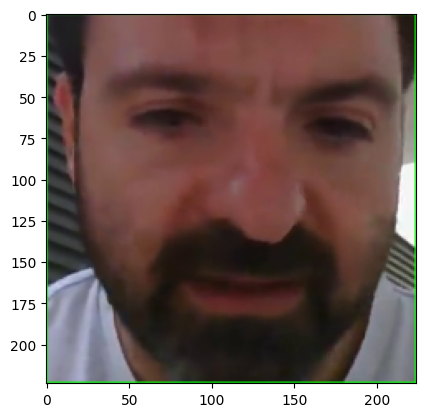

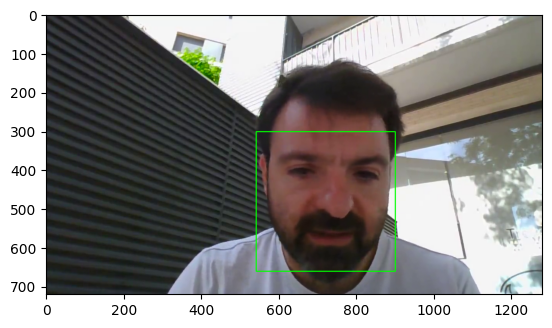

---------------- Not smiling ----------------
1/1 [==============================] - 0s 133ms/step
Prediction index 1
Prediction value 0.5967068672180176
Image after reshape


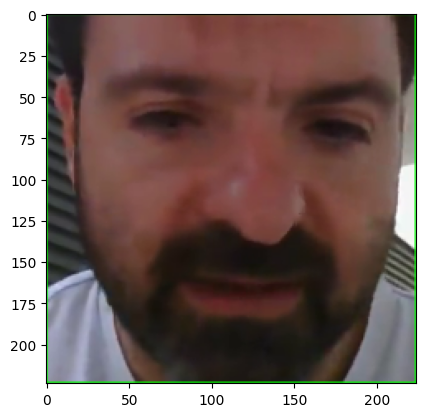

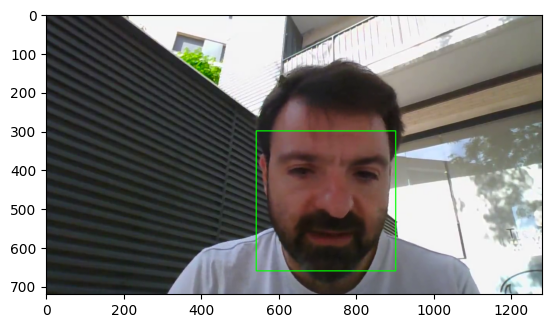

---------------- Not smiling ----------------
1/1 [==============================] - 0s 102ms/step
Prediction index 1
Prediction value 0.8564782738685608
Image after reshape


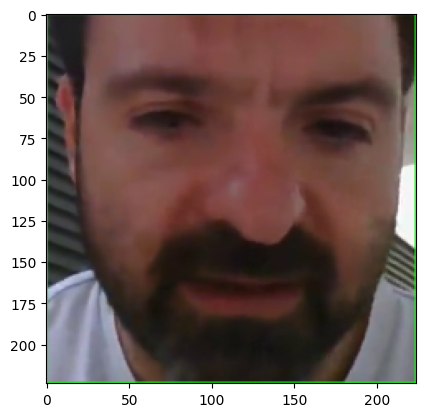

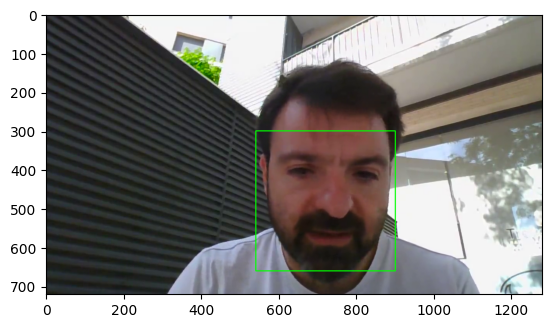

---------------- Not smiling ----------------
1/1 [==============================] - 0s 118ms/step
Prediction index 1
Prediction value 0.5708338618278503
Image after reshape


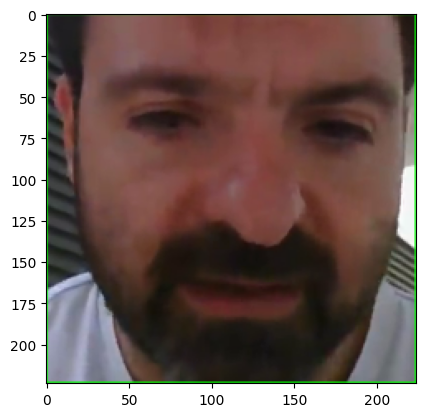

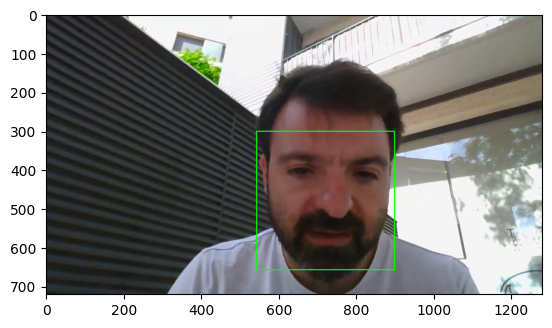

---------------- Not smiling ----------------
1/1 [==============================] - 0s 97ms/step
Prediction index 0
Prediction value 0.7574892044067383
Image after reshape


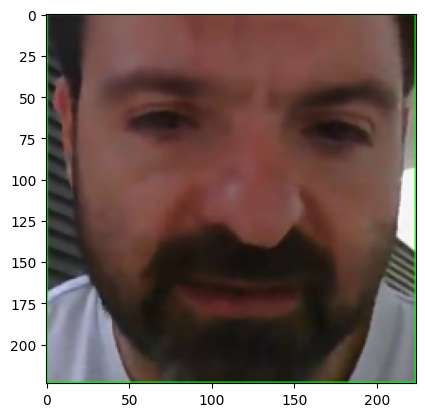

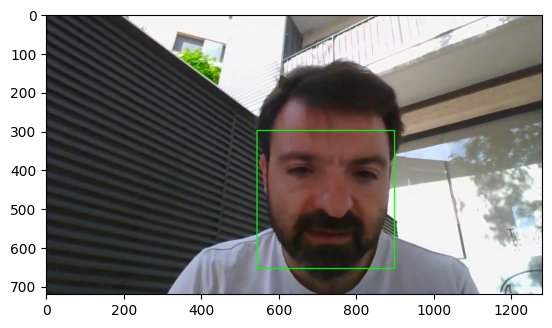

---------------- Not smiling ----------------
1/1 [==============================] - 0s 98ms/step
Prediction index 0
Prediction value 0.9012110829353333
Image after reshape


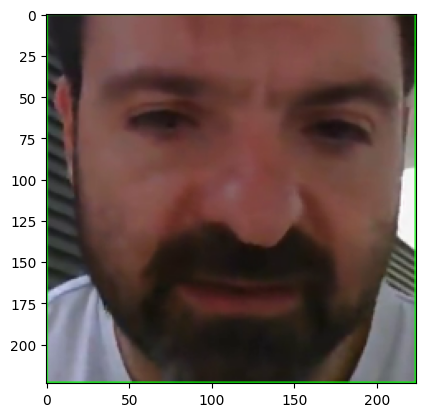

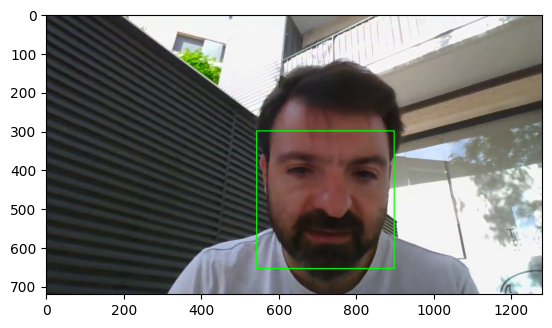

---------------- Not smiling ----------------
1/1 [==============================] - 0s 105ms/step
Prediction index 0
Prediction value 0.7290588617324829
Image after reshape


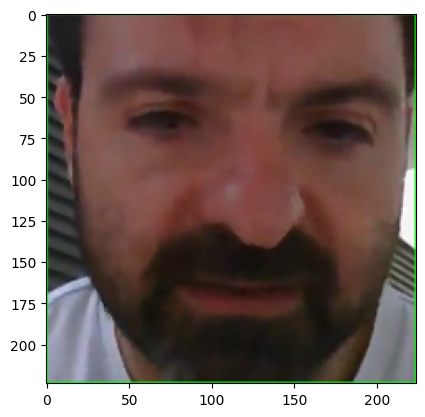

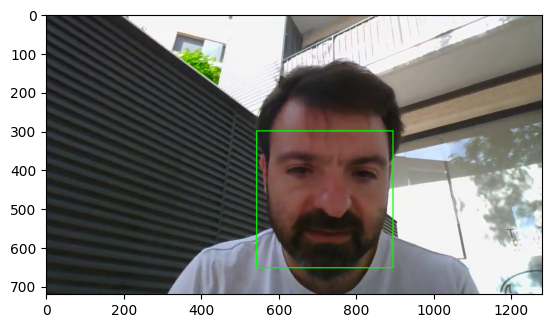

---------------- Not smiling ----------------
1/1 [==============================] - 0s 104ms/step
Prediction index 0
Prediction value 0.8008275628089905
Image after reshape


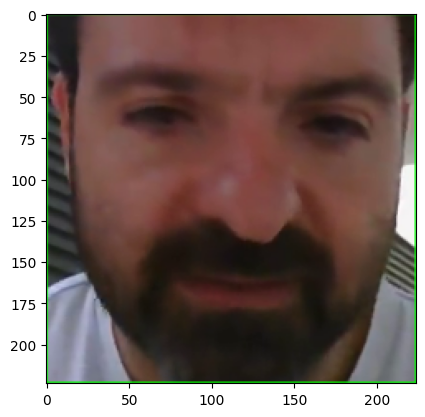

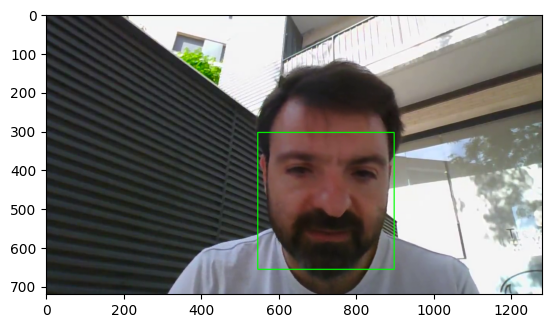

---------------- Not smiling ----------------
1/1 [==============================] - 0s 101ms/step
Prediction index 0
Prediction value 0.9735459089279175
Image after reshape


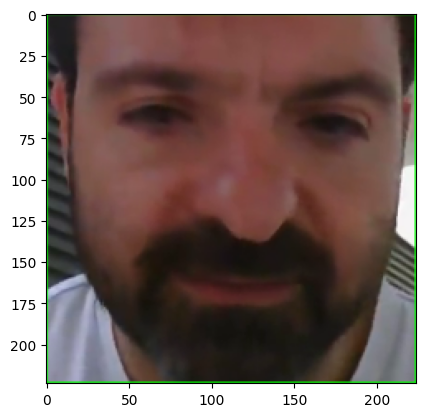

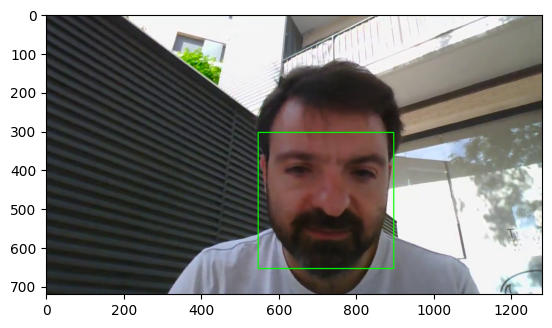

---------------- Not smiling ----------------
1/1 [==============================] - 0s 124ms/step
Prediction index 0
Prediction value 0.9112395644187927
Image after reshape


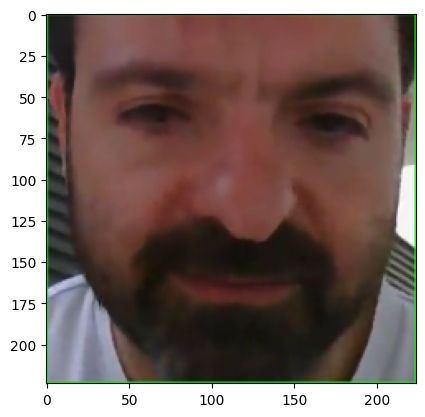

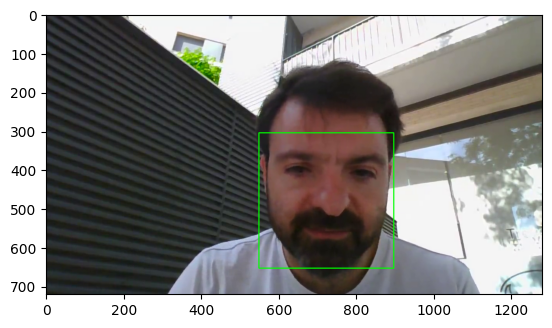

---------------- Not smiling ----------------
1/1 [==============================] - 0s 145ms/step
Prediction index 0
Prediction value 0.7834450006484985
Image after reshape


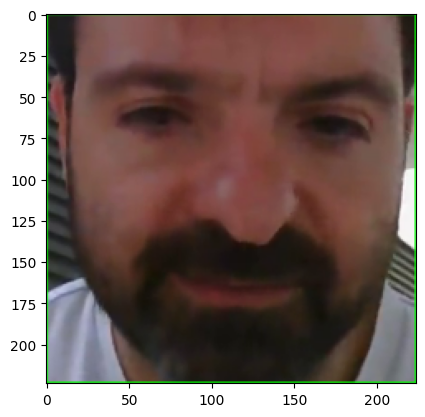

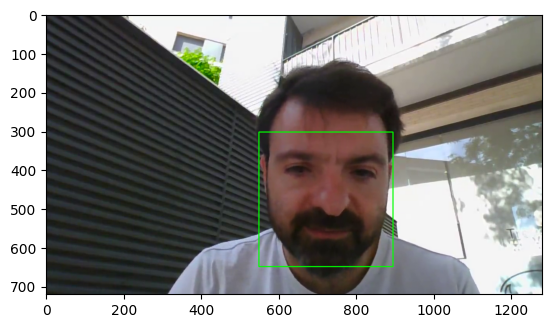

---------------- Not smiling ----------------
1/1 [==============================] - 0s 178ms/step
Prediction index 0
Prediction value 0.5472795963287354
Image after reshape


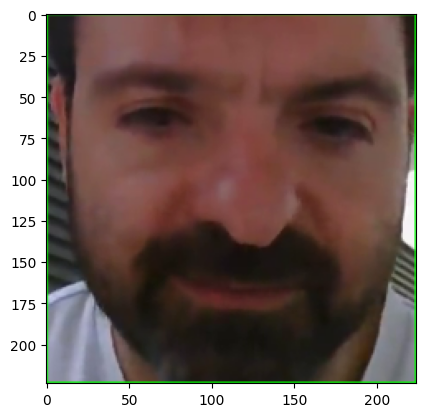

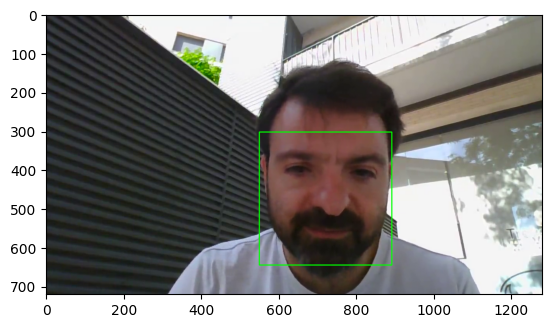

---------------- Not smiling ----------------
1/1 [==============================] - 0s 122ms/step
Prediction index 0
Prediction value 0.6320330500602722
Image after reshape


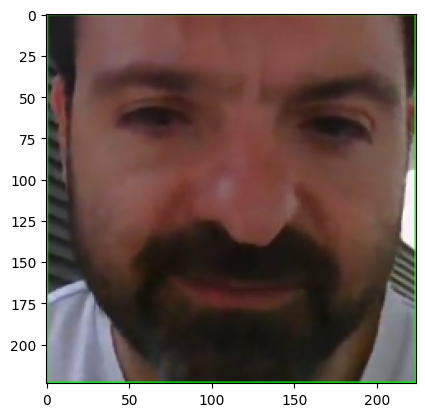

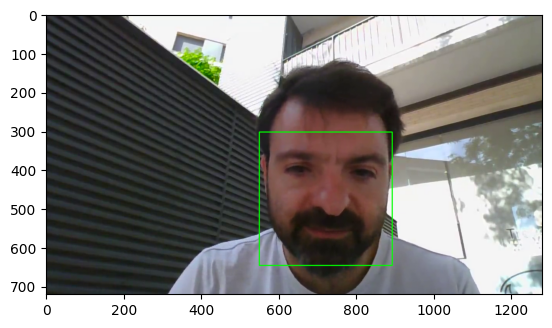

---------------- Not smiling ----------------
1/1 [==============================] - 0s 142ms/step
Prediction index 0
Prediction value 0.7296401262283325
Image after reshape


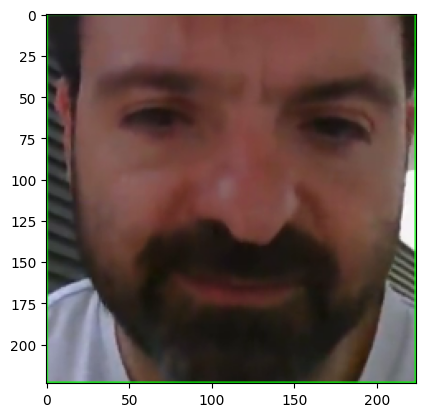

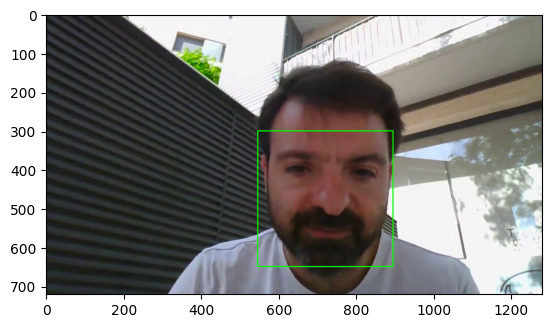

---------------- Not smiling ----------------
1/1 [==============================] - 0s 173ms/step
Prediction index 0
Prediction value 0.9384695887565613
Image after reshape


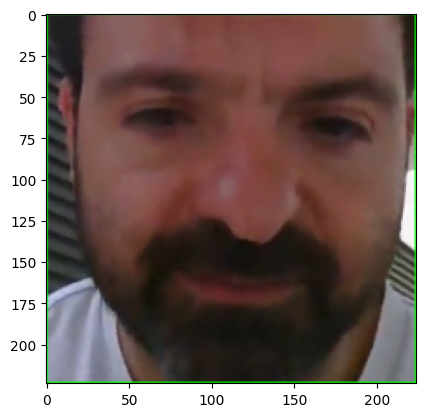

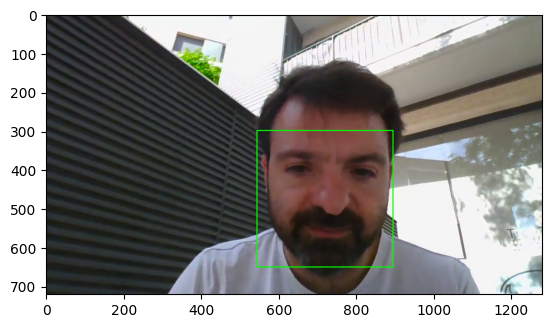

---------------- Not smiling ----------------
1/1 [==============================] - 0s 119ms/step
Prediction index 0
Prediction value 0.7306175231933594
Image after reshape


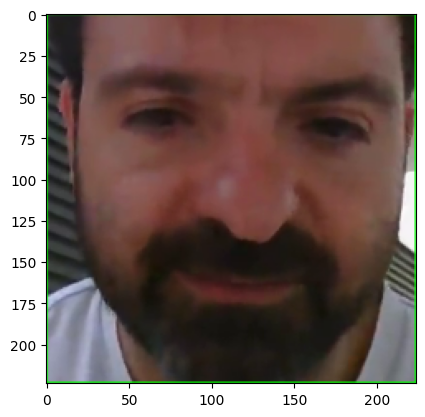

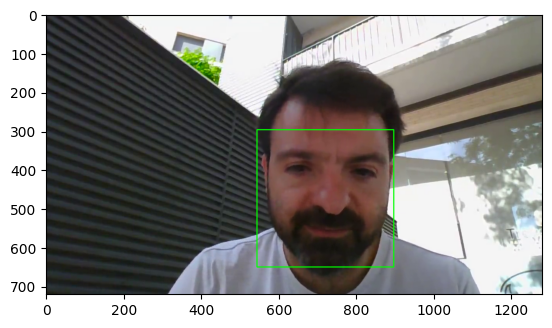

---------------- Not smiling ----------------
1/1 [==============================] - 0s 98ms/step
Prediction index 0
Prediction value 0.7119829654693604
Image after reshape


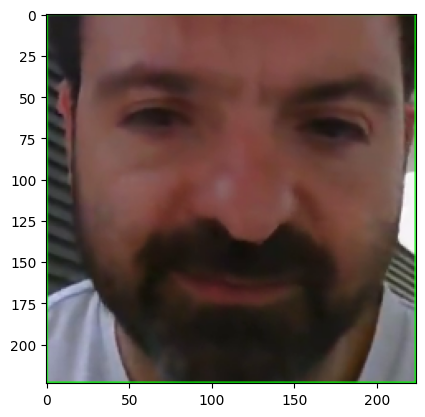

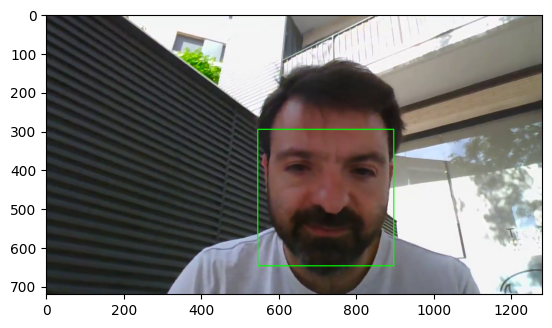

---------------- Not smiling ----------------
1/1 [==============================] - 0s 101ms/step
Prediction index 0
Prediction value 0.5533300042152405
Image after reshape


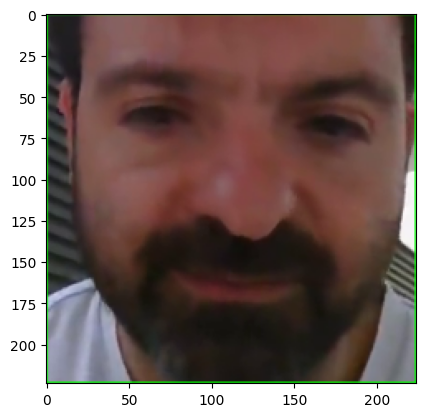

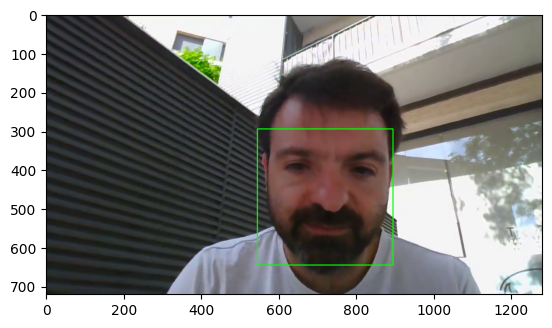

---------------- Not smiling ----------------
1/1 [==============================] - 0s 100ms/step
Prediction index 0
Prediction value 0.792218029499054
Image after reshape


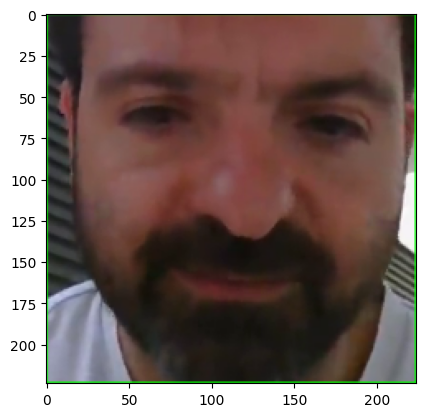

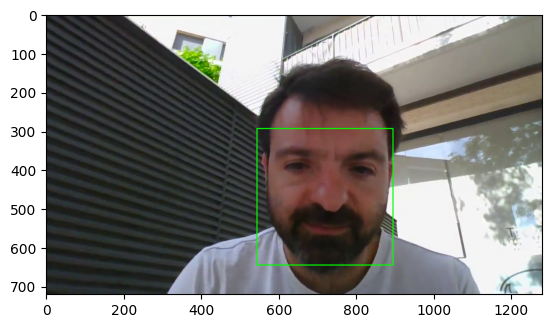

---------------- Not smiling ----------------
1/1 [==============================] - 0s 91ms/step
Prediction index 0
Prediction value 0.9171172380447388
Image after reshape


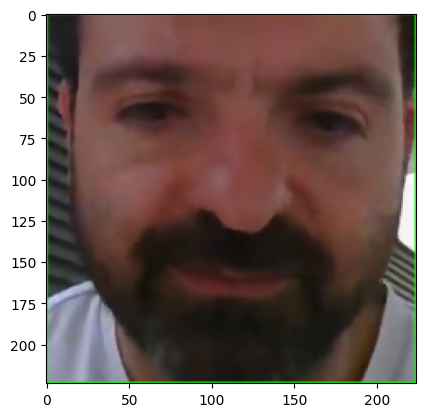

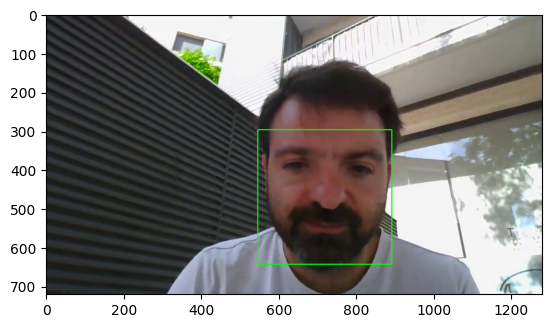

---------------- Not smiling ----------------
1/1 [==============================] - 0s 98ms/step
Prediction index 0
Prediction value 0.710691511631012
Image after reshape


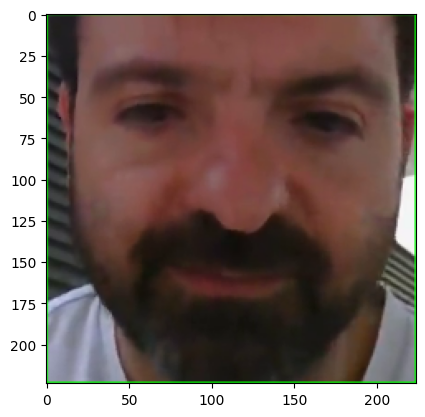

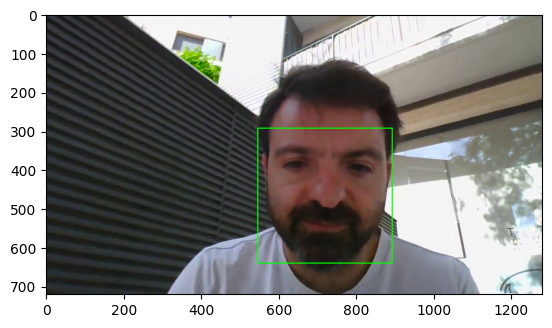

---------------- Not smiling ----------------
------------------ Continuous analysis ------------------


For the first 2 seconds of the video the result is: 
For this segment of the video IS smiling

For the last 2 of the video the result is: 
For this segment of the video IS NOT smiling
128.35048627853394


In [5]:
start, end = extract_video_segments(path_video,2)

In [3]:
import tensorflow as tf
import matplotlib.pyplot as plt
import time
import os
import cv2
import numpy as np
import mediapipe as mp
from google.colab.patches import cv2_imshow


class SmileDetectionAnalyzer:
    def __init__(self, model_path, threshold=0.9):
        self.model = tf.keras.models.load_model(model_path)
        self.threshold = threshold

    def predict_smile(self, img, plot_image=False):
        face_detection = mp.solutions.face_detection.FaceDetection()
        face = face_detection.process(img)
        detections = face.detections

        for detection in detections:
            bbox = detection.location_data.relative_bounding_box
            h, w, _ = img.shape
            x, y, width, height = int(bbox.xmin * w), int(bbox.ymin * h), int(bbox.width * w), int(bbox.height * h)
            crop_face = img[y:y + height, x:x + width]
            cv2.rectangle(img, (x, y), (x + width, y + height), (0, 255, 0), 2)

        resized_face = cv2.resize(crop_face, (224, 224))

        prediction_smile = self.model.predict(resized_face.reshape(1, 224, 224, 3))
        prediction_smile_value = np.max(prediction_smile[0])
        prediction_smile_index = np.argmax(prediction_smile)
        print(f"Prediction index {prediction_smile_index}")
        print(f"Prediction value {prediction_smile_value}")

        if plot_image:
            print("Image after reshape")
            plt.imshow(cv2.cvtColor(resized_face, cv2.COLOR_BGR2RGB))
            plt.show()
            plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
            plt.show()

        if prediction_smile_index == 0:
            print("---------------- Not smiling ----------------")
            prediction_value = 0
        else:
            if prediction_smile_value >= self.threshold:
                prediction_value = 1
                print("---------------- Smiling ----------------")
            else:
                prediction_value = 0
                print("---------------- Not smiling ----------------")

        return prediction_value

    @staticmethod
    def save_video(output_path, frames, fps):
        height, width, _ = frames[0].shape
        fourcc = cv2.VideoWriter_fourcc(*"mp4v")
        out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))
        for frame in frames:
            out.write(frame)
        out.release()

    @staticmethod
    def is_continuous_ones(arr):
        ones_count = 0
        for num in arr:
            if num == 1:
                ones_count += 1
                if ones_count >= 10:
                    print("For this segment of the video IS smiling")
                    general_prediction = 1
                    return general_prediction
            else:
                general_prediction = 0
        if general_prediction == 0:
            print("For this segment of the video IS NOT smiling")
        return general_prediction

    @staticmethod
    def processing_results(results):
        start_len = len(results)
        smiles_sum_start = np.sum(results)
        if smiles_sum_start >= start_len / 3:
            print("For this segment of the video is smiling :) ")
            general_prediction = 1
        else:
            print("For this segment of the video IS NOT smiling")
            general_prediction = 0
        return general_prediction

    def extract_video_segments(self, video_path, time_length, continue_results=True):
        tic = time.time()

        cap = cv2.VideoCapture(video_path)
        fps = cap.get(cv2.CAP_PROP_FPS)
        total_frames = cap.get(cv2.CAP_PROP_FRAME_COUNT)
        print(f"Total frames: {total_frames}")
        print(f"FPS: {fps}")
        try:
            video_length = int(total_frames) / int(fps)
            print(f"Video length: {video_length} seconds")
        except ZeroDivisionError:
            print("Could not get video length")

        start_frames = int(fps * time_length)
        end_frames = int(total_frames - fps * time_length)
        init_pred = []
        final_pred = []
        video_start = []
        video_end = []

        for frame_num in range(int(total_frames)):
            ret, frame = cap.read()
            if not ret:
                break
            if frame_num < start_frames:
                init_pred.append(self.predict_smile(frame))
                video_start.append(frame)
            if frame_num > end_frames:
                final_pred.append(self.predict_smile(frame))
                video_end.append(frame)

        cap.release()

        output_path_start = os.path.join(os.path.dirname(video_path), "start_segment.mp4")
        output_path_end = os.path.join(os.path.dirname(video_path), "end_segment.mp4")

        self.save_video(output_path_start, video_start, fps)
        self.save_video(output_path_end, video_end, fps)

        if continue_results:
            print("------------------ Continuous analysis ------------------\n\n")
            print(f"For the first {time_length} seconds of the video the result is: ")
            general_init_pred = self.is_continuous_ones(init_pred)
            print(f"\nFor the last {time_length} of the video the result is: ")
            general_final_pred = self.is_continuous_ones(final_pred)
        else:
            print("------------------ General analysis ------------------")
            print(f"For the first {time_length} seconds of the video the result is: ")
            general_init_pred = self.processing_results(init_pred)
            print(f"\nFor the last {time_length} of the video the result is: ")
            general_final_pred = self.processing_results(final_pred)

        toc = time.time()
        print(toc - tic)
        return init_pred, final_pred
analyzer = SmileDetectionAnalyzer(model_path="smile_model.h5", threshold=0.9)

init_pred, final_pred = analyzer.extract_video_segments(video_path="/content/video.mp4", time_length=10, continue_results=True)


Total frames: 1371.0
FPS: 24.0
Video length: 57.125 seconds
1/1 [==============================] - 1s 544ms/step
Prediction index 1
Prediction value 0.6849311590194702
---------------- Not smiling ----------------
1/1 [==============================] - 0s 63ms/step
Prediction index 1
Prediction value 0.743406355381012
---------------- Not smiling ----------------
1/1 [==============================] - 0s 68ms/step
Prediction index 0
Prediction value 0.547702431678772
---------------- Not smiling ----------------
1/1 [==============================] - 0s 62ms/step
Prediction index 1
Prediction value 0.7491965293884277
---------------- Not smiling ----------------
1/1 [==============================] - 0s 63ms/step
Prediction index 1
Prediction value 0.7085261344909668
---------------- Not smiling ----------------
1/1 [==============================] - 0s 70ms/step
Prediction index 1
Prediction value 0.7040334343910217
---------------- Not smiling ----------------
1/1 [==================